In [1]:
import tensorflow as tf
from tensorflow import keras

# FID Calculation

inc_model = keras.applications.InceptionV3(include_top=False, pooling='avg', input_shape=(150,150,3))

# scale an array of images to a new size
def scale_images(images, new_shape):
    images_list = list()
    for image in images:
        # resize with nearest neighbor interpolation
        new_image = np.resize(image, new_shape)
        # store
        images_list.append(new_image)
    return np.asarray(images_list)

# calculate frechet inception distance
def calculate_fid(model, images1, images2):
    # preprocessing
    images1 = images1.astype('float32')
    images2 = images2.astype('float32')
    # resize images
    images1 = scale_images(images1, (150,150,3))
    images2 = scale_images(images2, (150,150,3))

    images1 = keras.applications.inception_v3.preprocess_input(images1)
    images2 = keras.applications.inception_v3.preprocess_input(images2)
    # calculate activations
    act1 = model.predict(images1)
    act2 = model.predict(images2)
    # calculate mean and covariance statistics
    mu1, sigma1 = act1.mean(axis=0), np.cov(act1, rowvar=False, dtype=np.csingle)
    mu2, sigma2 = act2.mean(axis=0), np.cov(act2, rowvar=False, dtype=np.csingle)
    # calculate sum squared difference between means
    ssdiff = np.sum((mu1 - mu2)**2.0)
    # calculate sqrt of product between cov
    covmean = np.sqrt(sigma1*sigma2)
    # check and correct imaginary numbers from sqrt
    covmean = np.real(covmean)
    # calculate score
    fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return np.real(fid)

# define two fake collections of images
# images1 = np.random.randint(0, 255, 10*32*32*3)
# images1 = images1.reshape((10,32,32,3))
# images2 = np.random.randint(0, 255, 10*32*32*3)
# images2 = images2.reshape((10,32,32,3))

# print(calculate_fid(model, images1, images2))
# print(calculate_fid(model, images1, images1))
# print(calculate_fid(model, images2, images2))

2024-07-15 10:56:57.771765: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-15 10:56:58.409229: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2024-07-15 10:56:59.101081: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-15 10:56:59.101299: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. 

In [2]:
import os
import math
from abc import abstractmethod

from PIL import Image
import requests
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

%matplotlib inline

In [3]:
class Encoder(nn.Module):
    """The encoder for VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim):
        super().__init__()
        
        convs = []
        prev_dim = input_dim
        for conv_dim in conv_dims:
            convs.append(nn.Sequential(
                nn.Conv2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.convs = nn.Sequential(*convs)
        
        prev_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(prev_dim, fc_dim),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(fc_dim, latent_dim)
        self.fc_log_var = nn.Linear(fc_dim, latent_dim)
                    
    def forward(self, x):
        x = self.convs(x)
        x = torch.flatten(x, start_dim=1)
        x = self.fc(x)
        mu = self.fc_mu(x)
        log_var = self.fc_log_var(x)
        return mu, log_var
    
class Decoder(nn.Module):
    """The decoder for VAE"""
    
    def __init__(self, latent_dim, image_size, conv_dims, output_dim):
        super().__init__()
        
        fc_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, fc_dim),
            nn.ReLU()
        )
        self.conv_size = image_size // (2 ** len(conv_dims))
        
        de_convs = []
        prev_dim = conv_dims[-1]
        for conv_dim in conv_dims[::-1]:
            de_convs.append(nn.Sequential(
                nn.ConvTranspose2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.de_convs = nn.Sequential(*de_convs)
        self.pred_layer = nn.Sequential(
            nn.Conv2d(prev_dim, output_dim, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        x = self.fc(x)
        x = x.reshape(x.size(0), -1, self.conv_size, self.conv_size)
        x = self.de_convs(x)
        x = self.pred_layer(x)
        return x

In [4]:
class VAE(nn.Module):
    """VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim):
        super().__init__()
        
        self.encoder = Encoder(image_size, input_dim, conv_dims, fc_dim, latent_dim)
        self.decoder = Decoder(latent_dim, image_size, conv_dims, input_dim)
        
    def sample_z(self, mu, log_var):
        """sample z by reparameterization trick"""
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
    
    def forward(self, x):
        mu, log_var = self.encoder(x)
        z = self.sample_z(mu, log_var)
        recon = self.decoder(z)
        return recon, mu, log_var
    
    def compute_loss(self, x, recon, mu, log_var):
        """compute loss of VAE"""
        
        # KL loss
        kl_loss = (0.5*(log_var.exp() + mu ** 2 - 1 - log_var)).sum(1).mean()
        
        # recon loss
        recon_loss = F.binary_cross_entropy(recon, x, reduction="none").sum([1, 2, 3]).mean()
        
        return kl_loss + recon_loss

In [5]:
import glob 

class CelebA_Dataset(torch.utils.data.Dataset) :
    def __init__(self, data_path, transforms=None, subset=0) :
        self.paths = glob.glob(data_path + '/*.jpg')
        self.transforms = transforms
        if subset>0 : self.paths = self.paths[:subset]
        # self.data = []
        # for path in paths :
        #     self.data.append(plt.imread(path))
    def __len__(self) :
        return len(self.paths)
    def __getitem__(self, idx) :
        data = plt.imread(self.paths[idx])
        if self.transforms :
            data = self.transforms(data)
        return data


In [7]:
from torchvision.transforms import v2

batch_size = 64

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((64,64))
])

# use CelebA dataset
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
train_loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

image_size = 64
conv_dims = [128, 256]
fc_dim = 1024
latent_dim = 10 
epochs = 100

device = 'cuda:1' if torch.cuda.is_available() else 'cpu'
print(f'{device=}')

model = VAE(image_size, 3, conv_dims, fc_dim, latent_dim).to(device)
# model = torch.compile(model)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3)

print('params', sum([p.numel() for p in model.parameters()]))

device='cuda:1'
params 69038615


In [41]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.CenterCrop((150,150))
])

cropped_dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)


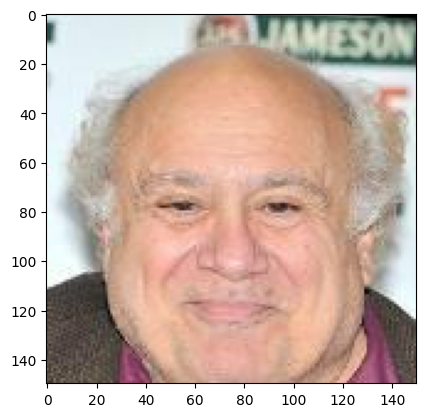

In [44]:
plt.imshow(cropped_dataset[0].swapaxes(0,1).swapaxes(1,2))

In [40]:
og_dataset[2].shape

(218, 178, 3)

In [22]:
np.ceil(54.2)

55.0

In [33]:
model = VAE(-1, 3, [128,256], 1024, 10, dropout=0)

In [35]:
model.encoder(torch.randn(1,3,218,178))[0].shape

torch.Size([1, 10])

In [36]:
model(torch.randn(1,3,218,178))[0].shape

torch.Size([1, 3, 220, 180])

## Analysis of the WoAug celeba model

In [8]:
model = torch.load('vae_celeba/model.pt')

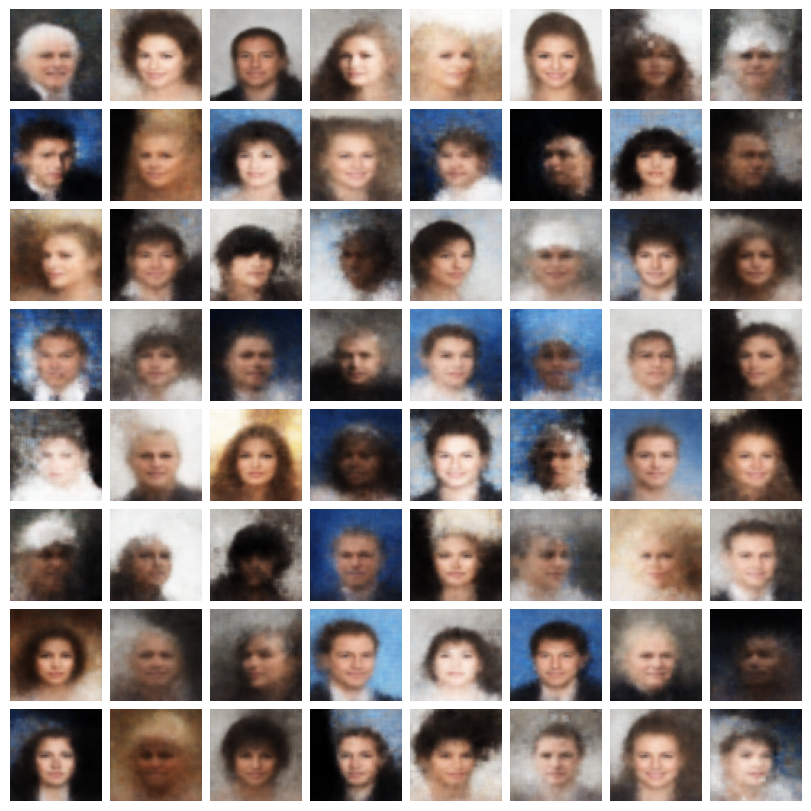

In [32]:
n_cols, n_rows = 8, 8
sample_zs = torch.randn(n_cols * n_rows, 10)
model.eval()
with torch.no_grad(): 
    generated_imgs = model.decoder(sample_zs.to(device))
    generated_imgs = generated_imgs.cpu().numpy()
generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(n_rows, n_cols, 3, 64, 64)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(n_rows, n_cols)
for n_col in range(n_cols):
    for n_row in range(n_rows):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [33]:
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
FID (64 images) : 59.12258529663086


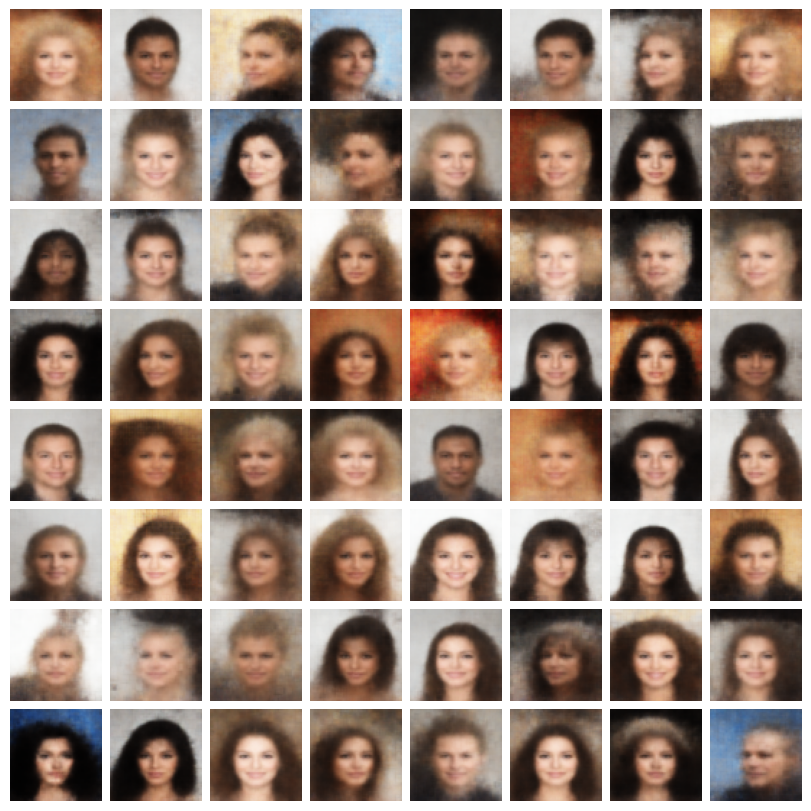

In [43]:
# sampling from N(mu, sigma)
import scipy
model.eval()
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
with torch.no_grad() : pivots = model.encoder(next(iter(loader)).cuda(1))[0].cpu()
mu = pivots.mean(dim=0, keepdims=True)
sigma = scipy.linalg.sqrtm(pivots.transpose(0,1).cov()).real
sample_zs = (mu + torch.randn(64, latent_dim)@sigma).to('cuda:1')
with torch.no_grad():
    generated_imgs = model.decoder(sample_zs)
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, image_size, image_size)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")

In [44]:
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
FID (64 images) : 46.553733825683594


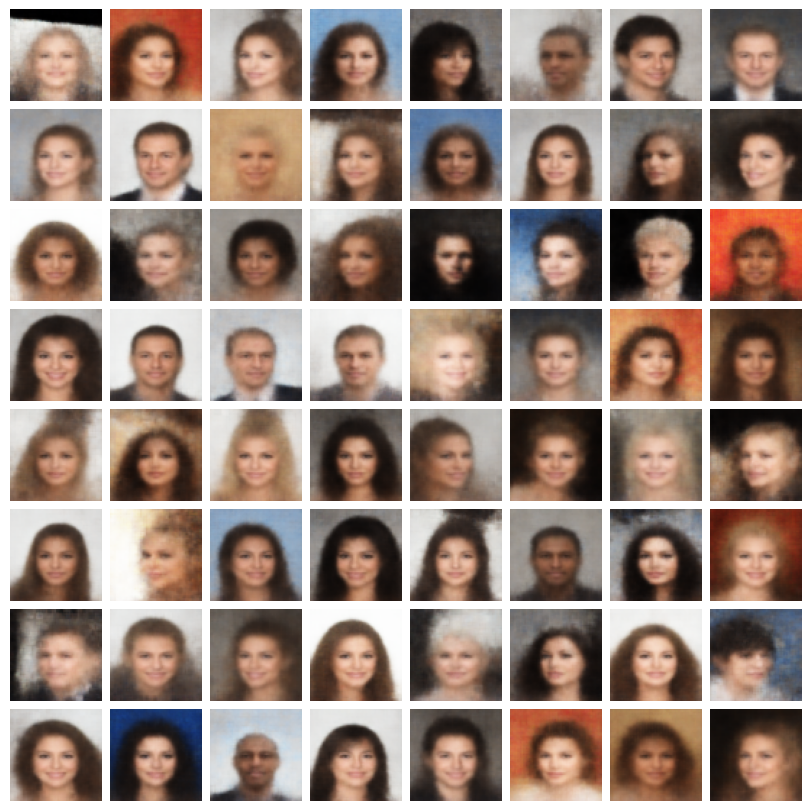

In [45]:
# baseline : reconstructions
with torch.no_grad() :
    recons = model.decoder(pivots.cuda(1)).cpu()
recons = np.array(recons * 255, dtype=np.uint8).reshape(8, 8, 3, image_size, image_size)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(recons[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [46]:
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, recons.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
FID (64 images) : 24.135459899902344


torch.Size([64, 10])


  0%|          | 0/13200 [00:00<?, ?it/s]

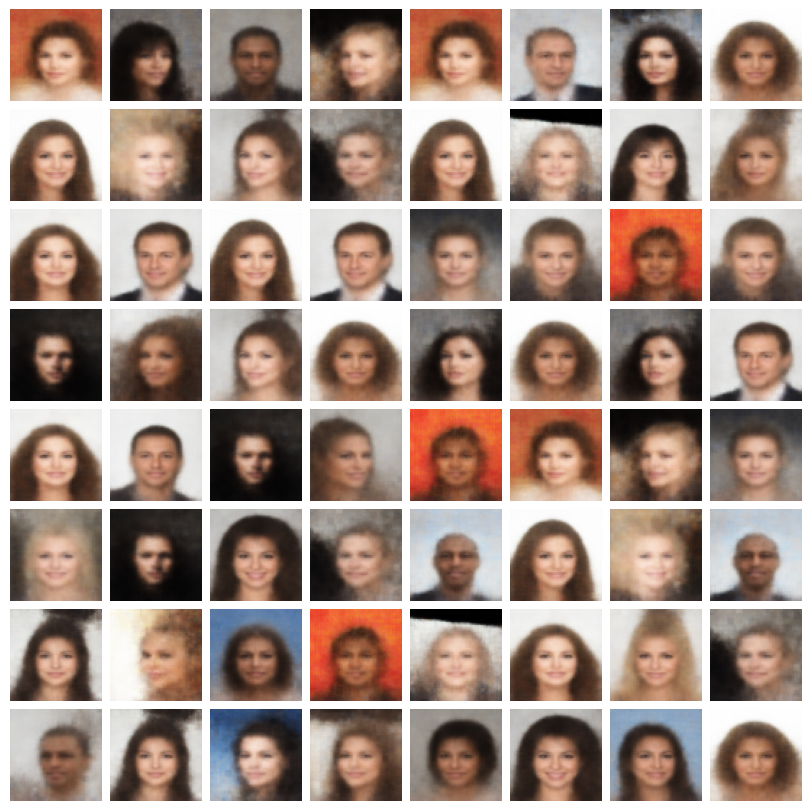

In [47]:
## sampling from langevin MC

#### HPARAMS ####
GAUSE_STD = 1
STEP = 1 
WEIGHT = 1
K = 50
#################

def potential(z, encodings, sigma=GAUSE_STD, pot=True) :
    z = z.view(-1, 1, encodings.shape[-1])
    ans = 0
    ans = torch.exp(-torch.norm(z-encodings, dim=-1)**2 / (2*sigma*sigma)).max(-1).values
    if pot : return -torch.log(ans)
    return ans

def log_Q(potential, encodings, z_prime, z, step):
    z.requires_grad_()
    grad = torch.autograd.grad(potential(z, encodings).mean(), z)[0]
    return -(torch.norm(z_prime - z + step * grad, p=2, dim=1) ** 2) / (4 * step)

def metropolis_adjusted_langevin_algorithm(potential, encodings, n_samples=100000, step=0.001, k=50, use_conf=False):
    burn_in = 10000
    weight = WEIGHT
    Z0 = torch.randn(1, encodings.shape[-1])
    THRESH = 0.3; c=0; p=1
    Zi = Z0
    samples = []
    returnable = []
    sample_conf = []
    log_ratios = []
    grads = []
    acc = []
    steps = []
    pbar = tqdm(range(k*n_samples + burn_in)) if not use_conf else tqdm(range(burn_in))
    for _ in pbar :
        Zi.requires_grad_()
        u = potential(Zi, encodings).mean()
        grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
        st_one = -step *grad
        st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
        with torch.no_grad() : 
            if potential(Zi, encodings, pot=False) < 0.9 : st = st_one
            else : st = st_two
        prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
        log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                    log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
        log_ratios.append(log_ratio.detach().item())
        if True : # torch.rand(1) < torch.exp(log_ratio):
            Zi = prop_Zi; acc.append(1)
        else : acc.append(0)
        samples.append(Zi.detach().numpy())
        sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
    if use_conf :
        print('Now Sampling...')
        while True :
            Zi.requires_grad_()
            u = potential(Zi, encodings).mean()
            grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
            st_one = -step*grad
            st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
            with torch.no_grad() : 
                if potential(Zi, encodings, pot=False) <0.9 : st = st_one
                else : st = st_two
            # st = st_one + st_two # 3*st_one/st_one.norm() + 3*st_two/st_two.norm()
            # st /= st.norm()
            prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
            log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                        log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
            log_ratios.append(log_ratio.detach().item())
            if torch.rand(1) < torch.exp(log_ratio):
                Zi = prop_Zi; acc.append(1)
            else : acc.append(0)
            if potential(Zi.detach(), encodings, pot=False)>=THRESH : returnable.append(Zi.detach().numpy()); c+=1; print(c, end=' : ')
            sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
            if c>=n_samples : break
        return np.concatenate(returnable, 0), grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
    return np.concatenate(samples, 0)[burn_in::k], grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
print(pivots.shape)
latents, grads, acc, burns, confs, steps, log_ratios = metropolis_adjusted_langevin_algorithm(potential, pivots, n_samples=64, k=K, step=STEP, use_conf=False) # change 64 to 1000 later

model.eval()
with torch.no_grad():
    generated_imgs = model.decoder(torch.tensor(latents, device='cuda:1'))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs[:64] * 255, dtype=np.uint8).reshape(8, 8, 3, image_size, image_size)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [54]:
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
FID (64 images) : 36.02619934082031


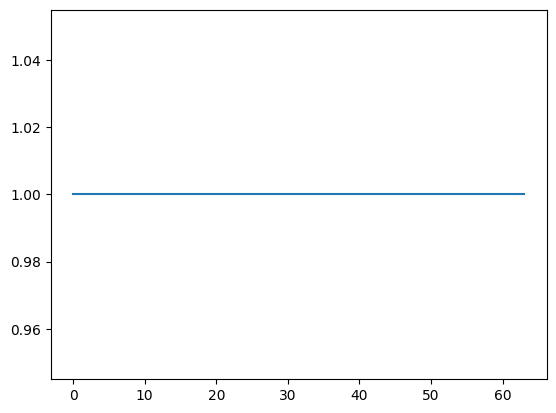

In [52]:
plt.plot(confs[10000::K])

In [56]:
pivots_walk = pivots[0] + torch.linspace(0, 1, 8)[:,None]*(pivots[1]-pivots[0])[None,:]
for i in range(1, 8) :
    pivots_walk = torch.cat((pivots_walk, pivots[2*i] + torch.linspace(0, 1, 8)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:]), dim=0)
pivots_walk.shape

torch.Size([64, 10])

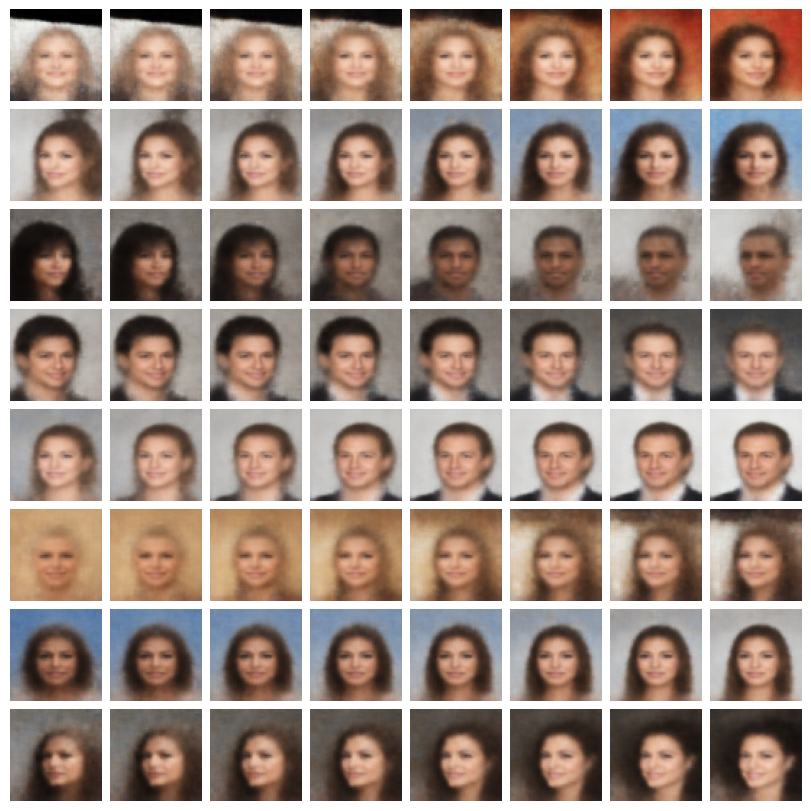

In [58]:
model.eval()
with torch.no_grad():
    generated_imgs = model.decoder(pivots_walk.cuda(1))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, image_size, image_size)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

## Analysis of the WAug celeba model

In [59]:
model2 = torch.load('vae_celeba_aug_dropout/model.pt')

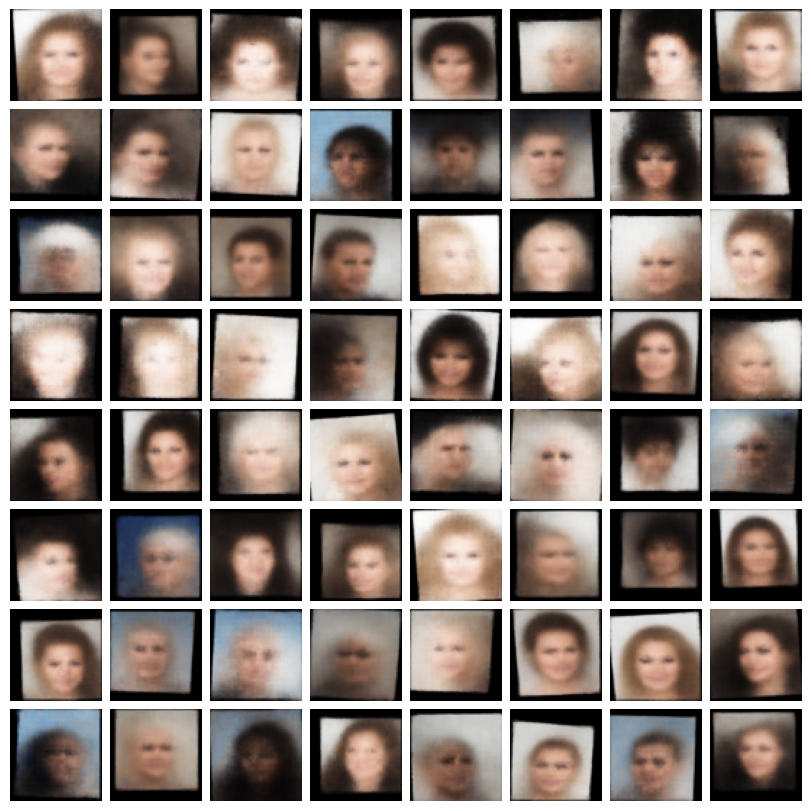

In [64]:
n_cols, n_rows = 8, 8
sample_zs = torch.randn(n_cols * n_rows, 10)
model2.eval()
with torch.no_grad(): 
    generated_imgs = model2.decoder(sample_zs.to(device))
    generated_imgs = generated_imgs.cpu().numpy()
generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(n_rows, n_cols, 3, 64, 64)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(n_rows, n_cols)
for n_col in range(n_cols):
    for n_row in range(n_rows):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

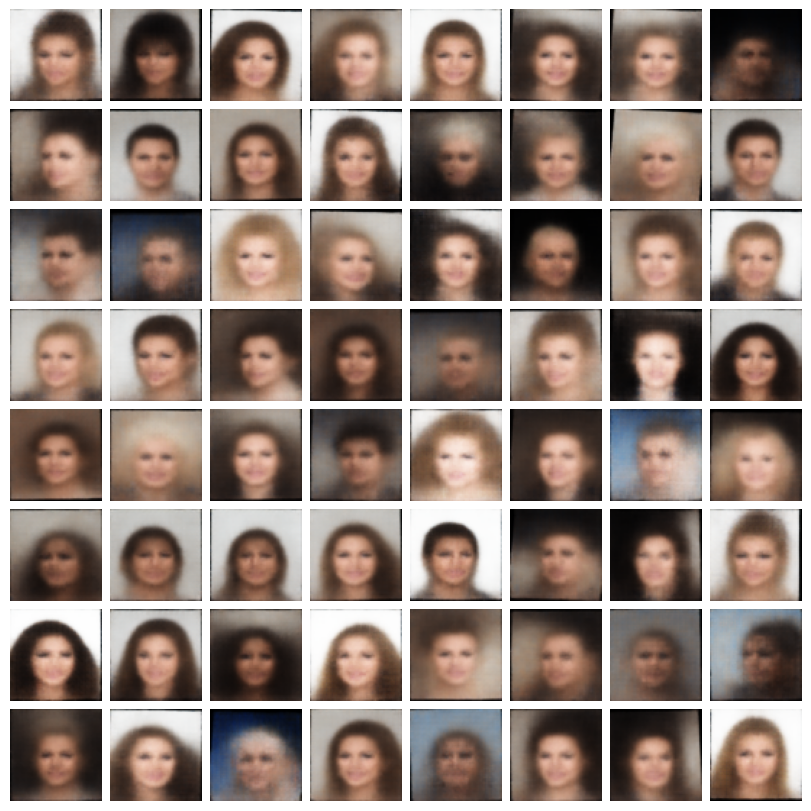

In [65]:
# sampling from N(mu, sigma)
import scipy
model2.eval()
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
with torch.no_grad() : pivots = model2.encoder(next(iter(loader)).cuda(1))[0].cpu()
mu = pivots.mean(dim=0, keepdims=True)
sigma = scipy.linalg.sqrtm(pivots.transpose(0,1).cov()).real
sample_zs = (mu + torch.randn(64, latent_dim)@sigma).to('cuda:1')
with torch.no_grad():
    generated_imgs = model2.decoder(sample_zs)
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, image_size, image_size)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")

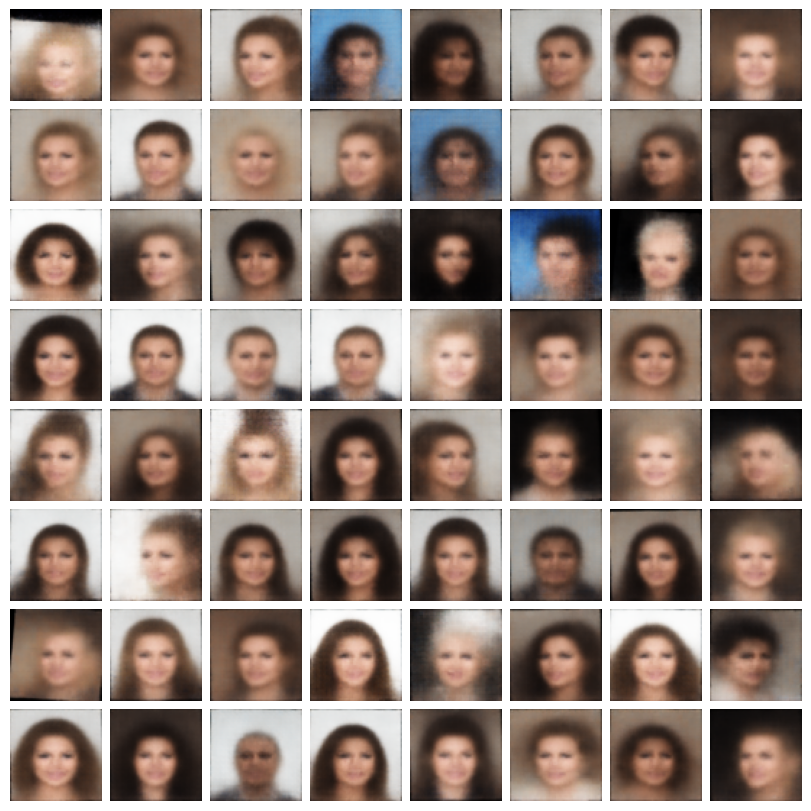

In [66]:
# baseline : reconstructions
with torch.no_grad() :
    recons = model2.decoder(pivots.cuda(1)).cpu()
recons = np.array(recons * 255, dtype=np.uint8).reshape(8, 8, 3, image_size, image_size)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(recons[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

torch.Size([64, 10])


  0%|          | 0/13200 [00:00<?, ?it/s]

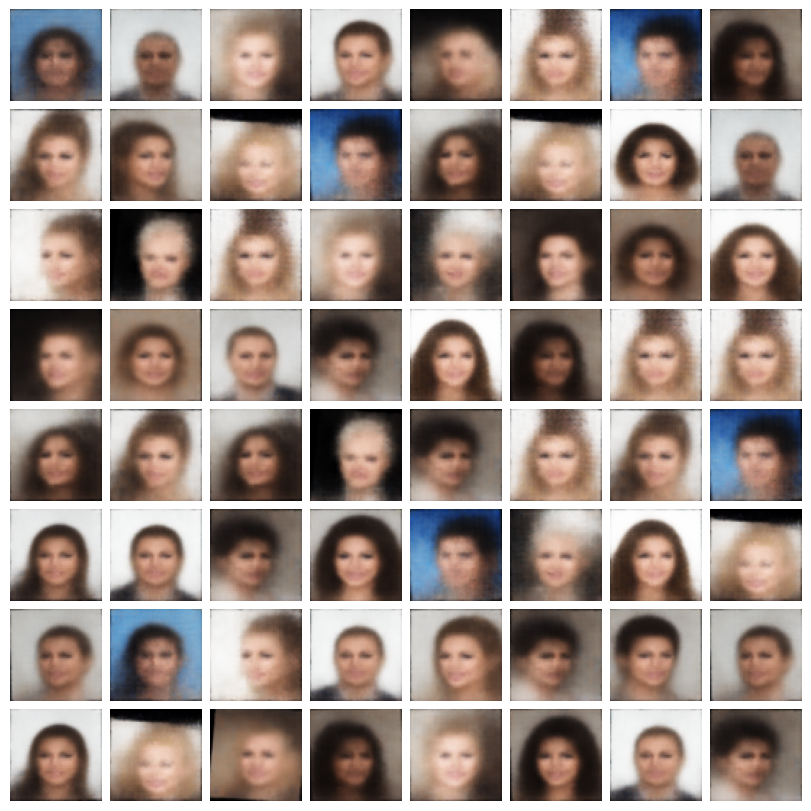

In [67]:
## sampling from langevin MC

#### HPARAMS ####
GAUSE_STD = 1
STEP = 1 
WEIGHT = 1
K = 50
#################

def potential(z, encodings, sigma=GAUSE_STD, pot=True) :
    z = z.view(-1, 1, encodings.shape[-1])
    ans = 0
    ans = torch.exp(-torch.norm(z-encodings, dim=-1)**2 / (2*sigma*sigma)).max(-1).values
    if pot : return -torch.log(ans)
    return ans

def log_Q(potential, encodings, z_prime, z, step):
    z.requires_grad_()
    grad = torch.autograd.grad(potential(z, encodings).mean(), z)[0]
    return -(torch.norm(z_prime - z + step * grad, p=2, dim=1) ** 2) / (4 * step)

def metropolis_adjusted_langevin_algorithm(potential, encodings, n_samples=100000, step=0.001, k=50, use_conf=False):
    burn_in = 10000
    weight = WEIGHT
    Z0 = torch.randn(1, encodings.shape[-1])
    THRESH = 0.3; c=0; p=1
    Zi = Z0
    samples = []
    returnable = []
    sample_conf = []
    log_ratios = []
    grads = []
    acc = []
    steps = []
    pbar = tqdm(range(k*n_samples + burn_in)) if not use_conf else tqdm(range(burn_in))
    for _ in pbar :
        Zi.requires_grad_()
        u = potential(Zi, encodings).mean()
        grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
        st_one = -step *grad
        st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
        with torch.no_grad() : 
            if potential(Zi, encodings, pot=False) < 0.9 : st = st_one
            else : st = st_two
        prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
        log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                    log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
        log_ratios.append(log_ratio.detach().item())
        if True : # torch.rand(1) < torch.exp(log_ratio):
            Zi = prop_Zi; acc.append(1)
        else : acc.append(0)
        samples.append(Zi.detach().numpy())
        sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
    if use_conf :
        print('Now Sampling...')
        while True :
            Zi.requires_grad_()
            u = potential(Zi, encodings).mean()
            grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
            st_one = -step*grad
            st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
            with torch.no_grad() : 
                if potential(Zi, encodings, pot=False) <0.9 : st = st_one
                else : st = st_two
            # st = st_one + st_two # 3*st_one/st_one.norm() + 3*st_two/st_two.norm()
            # st /= st.norm()
            prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
            log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                        log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
            log_ratios.append(log_ratio.detach().item())
            if torch.rand(1) < torch.exp(log_ratio):
                Zi = prop_Zi; acc.append(1)
            else : acc.append(0)
            if potential(Zi.detach(), encodings, pot=False)>=THRESH : returnable.append(Zi.detach().numpy()); c+=1; print(c, end=' : ')
            sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
            if c>=n_samples : break
        return np.concatenate(returnable, 0), grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
    return np.concatenate(samples, 0)[burn_in::k], grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
print(pivots.shape)
latents, grads, acc, burns, confs, steps, log_ratios = metropolis_adjusted_langevin_algorithm(potential, pivots, n_samples=64, k=K, step=STEP, use_conf=False) # change 64 to 1000 later

model.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(torch.tensor(latents, device='cuda:1'))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs[:64] * 255, dtype=np.uint8).reshape(8, 8, 3, image_size, image_size)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

## VAE_wKL_160_20d

In [8]:
class Encoder(nn.Module):
    """The encoder for VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=0.25):
        super().__init__()
        
        convs = []
        prev_dim = input_dim
        for conv_dim in conv_dims:
            convs.append(nn.Sequential(
                nn.Conv2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.convs = nn.Sequential(*convs)
        self.do = nn.Dropout(p=dropout)
        prev_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(prev_dim, fc_dim),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(fc_dim, latent_dim)
        self.fc_log_var = nn.Linear(fc_dim, latent_dim)
                    
    def forward(self, x):
        x = self.do(self.convs(x))
        x = torch.flatten(x, start_dim=1)
        x = self.fc(x)
        mu = self.fc_mu(x)
        log_var = self.fc_log_var(x)
        return mu, log_var
    
class Decoder(nn.Module):
    """The decoder for VAE"""
    
    def __init__(self, latent_dim, image_size, conv_dims, output_dim):
        super().__init__()
        
        fc_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, fc_dim),
            nn.ReLU()
        )
        self.conv_size1 = self.conv_size2 = image_size // (2 ** len(conv_dims))
        
        de_convs = []
        prev_dim = conv_dims[-1]
        for conv_dim in conv_dims[::-1]:
            de_convs.append(nn.Sequential(
                nn.ConvTranspose2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.de_convs = nn.Sequential(*de_convs)
        self.pred_layer = nn.Sequential(
            nn.Conv2d(prev_dim, output_dim, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.fc(x)
        x = x.reshape(x.size(0), -1, self.conv_size1, self.conv_size2)
        x = self.de_convs(x)
        x = self.pred_layer(x)
        return x

class VAE(nn.Module):
    """VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout):
        super().__init__()
        
        self.encoder = Encoder(image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=dropout)
        self.decoder = Decoder(latent_dim, image_size, conv_dims, input_dim)
        
    def sample_z(self, mu, log_var):
        """sample z by reparameterization trick"""
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
    
    def forward(self, x):
        mu, log_var = self.encoder(x)
        z = self.sample_z(mu, log_var)
        recon = self.decoder(z)
        return recon, mu, log_var
    
    def compute_loss(self, x, recon, mu, log_var):
        """compute loss of VAE"""
        
        # kl_loss
        kl_loss = (0.5*(log_var.exp() + mu ** 2 - 1 - log_var)).sum(1).mean()
        # recon loss
        x = x.clip(max=1., min=0.)
        recon_loss = F.binary_cross_entropy(recon, x, reduction="none").sum([1, 2, 3]).mean()
        
        return kl_loss + recon_loss

In [9]:
model = VAE(160, 3, [64, 128, 256], 120, 20, dropout=0)
model = torch.load('vae_celeba160/modelFinal.pt')
device = next(model.parameters()).device
sum([p.numel() for p in model.parameters()]), next(model.parameters()).device

(108381483, device(type='cuda', index=1))

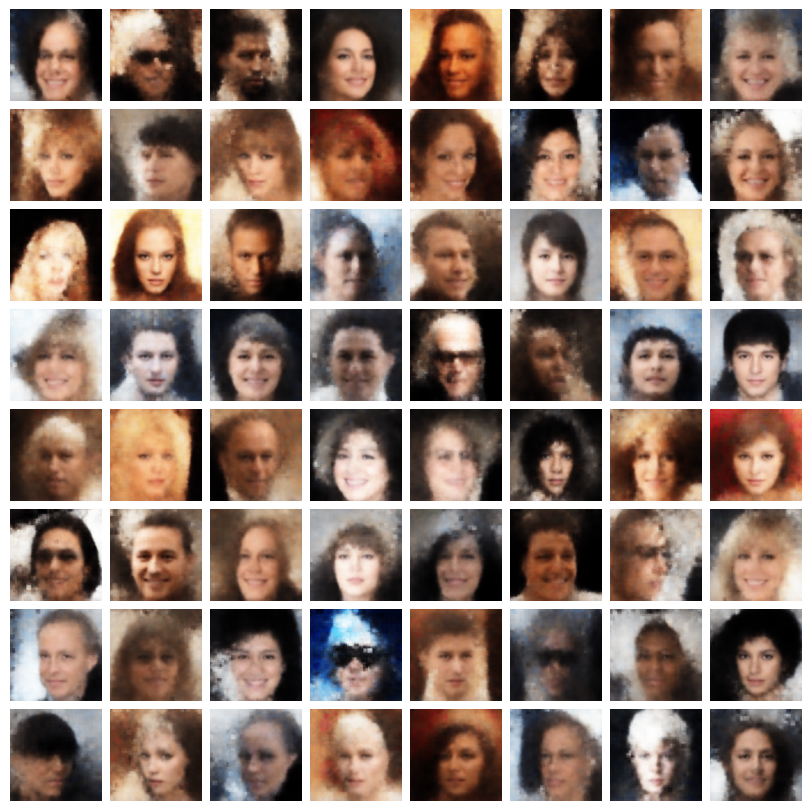

In [10]:
n_cols, n_rows = 8, 8
sample_zs = torch.randn(n_cols * n_rows, 20)
model.eval()
with torch.no_grad(): 
    generated_imgs = model.decoder(sample_zs.to(device))
    generated_imgs = generated_imgs.cpu().numpy()
generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(n_rows, n_cols, 3, 160,160)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(n_rows, n_cols)
for n_col in range(n_cols):
    for n_row in range(n_rows):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [16]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 164ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
FID (64 images) : 46.14801788330078


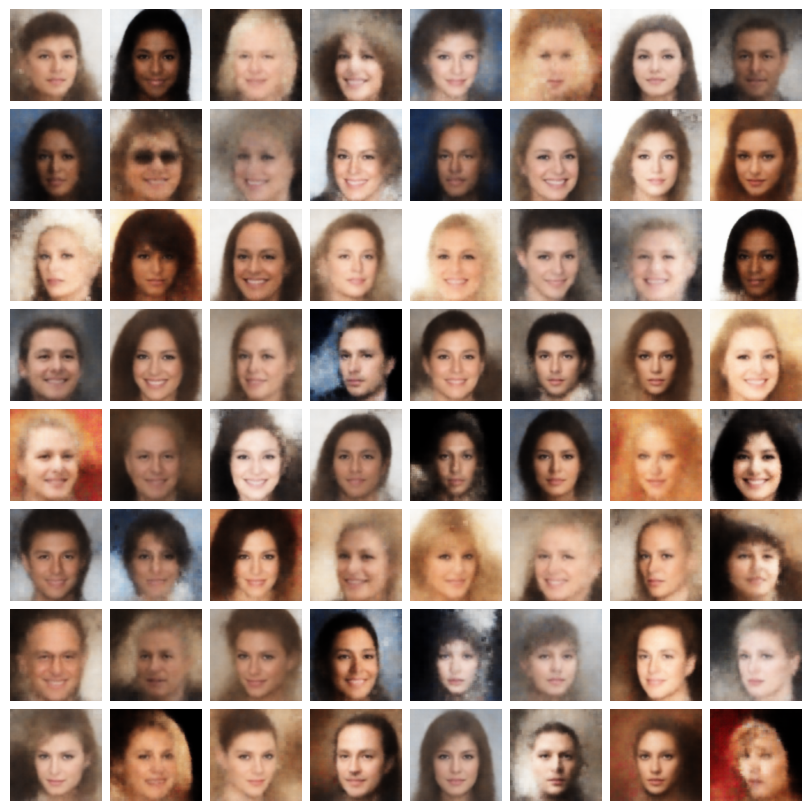

In [12]:
# sampling from N(mu, sigma)
import scipy

transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
model.eval()
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
with torch.no_grad() : pivots = model.encoder(next(iter(loader)).cuda(1))[0].cpu()
mu = pivots.mean(dim=0, keepdims=True)
sigma = scipy.linalg.sqrtm(pivots.transpose(0,1).cov()).real
sample_zs = (mu + torch.randn(64, 20)@sigma).to('cuda:1')
with torch.no_grad():
    generated_imgs = model.decoder(sample_zs)
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")

In [21]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
FID (64 images) : 41.256065368652344


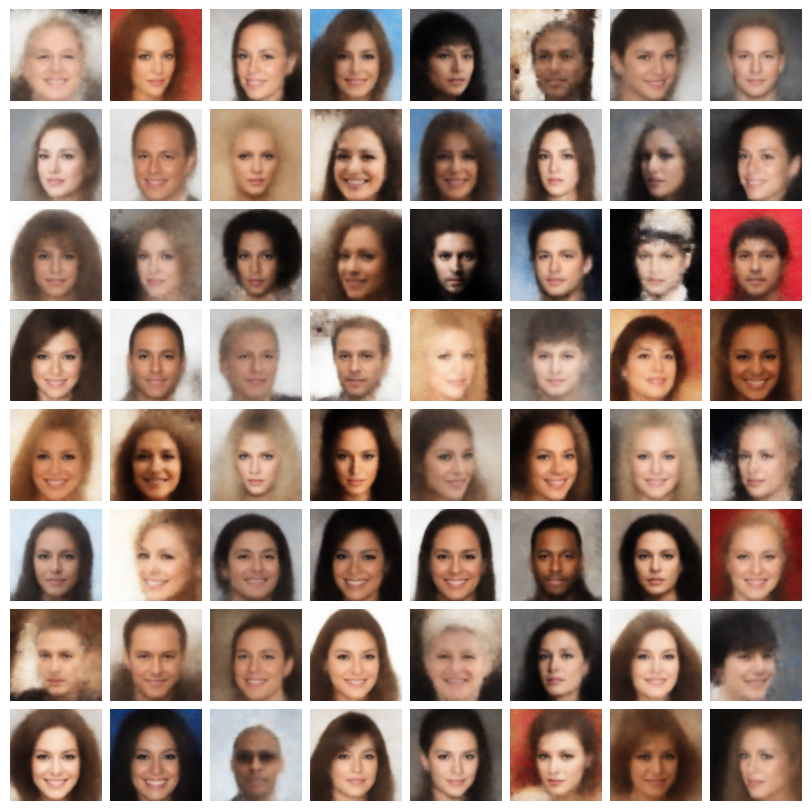

In [13]:
# baseline : reconstructions
with torch.no_grad() :
    recons = model.decoder(pivots.cuda(1)).cpu()
recons = np.array(recons * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(recons[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [14]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, recons.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 168ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
FID (64 images) : 39.73120880126953


torch.Size([64, 20])


  0%|          | 0/35000 [00:00<?, ?it/s]

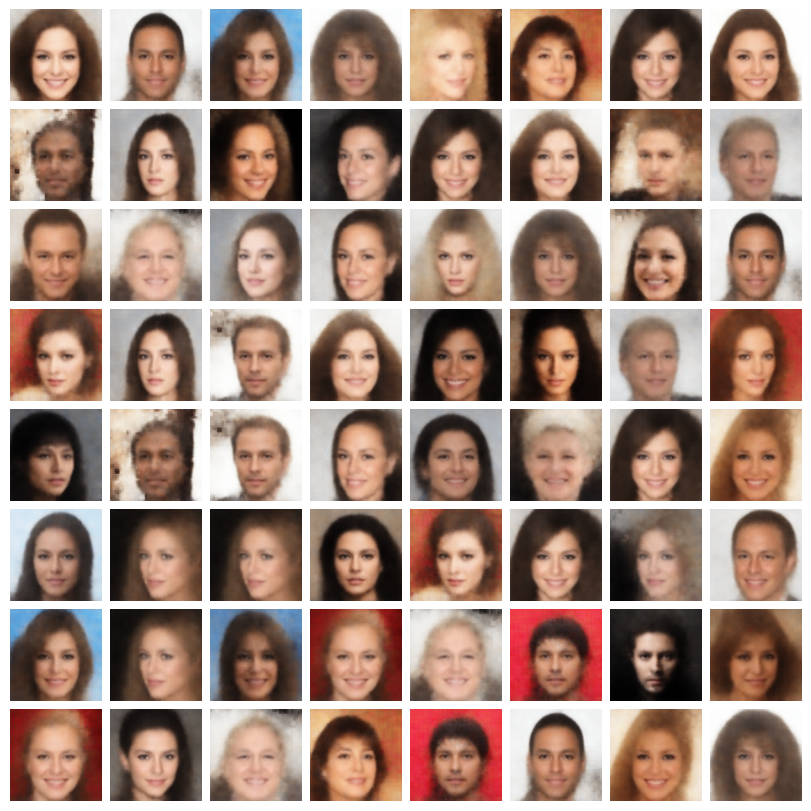

In [15]:
## sampling from langevin MC

#### HPARAMS ####
GAUSE_STD = 1
STEP = 1 
WEIGHT = 1
K = 50
#################

def potential(z, encodings, sigma=GAUSE_STD, pot=True) :
    z = z.view(-1, 1, encodings.shape[-1])
    ans = 0
    ans = torch.exp(-torch.norm(z-encodings, dim=-1)**2 / (2*sigma*sigma)).max(-1).values
    if pot : return -torch.log(ans)
    return ans

def log_Q(potential, encodings, z_prime, z, step):
    z.requires_grad_()
    grad = torch.autograd.grad(potential(z, encodings).mean(), z)[0]
    return -(torch.norm(z_prime - z + step * grad, p=2, dim=1) ** 2) / (4 * step)

def metropolis_adjusted_langevin_algorithm(potential, encodings, n_samples=100000, step=0.001, k=50, use_conf=False):
    burn_in = 10000
    weight = WEIGHT
    Z0 = torch.randn(1, encodings.shape[-1])
    THRESH = 0.3; c=0; p=1
    Zi = Z0
    samples = []
    returnable = []
    sample_conf = []
    log_ratios = []
    grads = []
    acc = []
    steps = []
    pbar = tqdm(range(k*n_samples + burn_in)) if not use_conf else tqdm(range(burn_in))
    for _ in pbar :
        Zi.requires_grad_()
        u = potential(Zi, encodings).mean()
        grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
        st_one = -step *grad
        st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
        with torch.no_grad() : 
            if potential(Zi, encodings, pot=False) < 0.9 : st = st_one
            else : st = st_two
        prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
        log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                    log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
        log_ratios.append(log_ratio.detach().item())
        if True : # torch.rand(1) < torch.exp(log_ratio):
            Zi = prop_Zi; acc.append(1)
        else : acc.append(0)
        samples.append(Zi.detach().numpy())
        sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
    if use_conf :
        print('Now Sampling...')
        while True :
            Zi.requires_grad_()
            u = potential(Zi, encodings).mean()
            grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
            st_one = -step*grad
            st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
            with torch.no_grad() : 
                if potential(Zi, encodings, pot=False) <0.9 : st = st_one
                else : st = st_two
            # st = st_one + st_two # 3*st_one/st_one.norm() + 3*st_two/st_two.norm()
            # st /= st.norm()
            prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
            log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                        log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
            log_ratios.append(log_ratio.detach().item())
            if torch.rand(1) < torch.exp(log_ratio):
                Zi = prop_Zi; acc.append(1)
            else : acc.append(0)
            if potential(Zi.detach(), encodings, pot=False)>=THRESH : returnable.append(Zi.detach().numpy()); c+=1; print(c, end=' : ')
            sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
            if c>=n_samples : break
        return np.concatenate(returnable, 0), grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
    return np.concatenate(samples, 0)[burn_in::k], grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
print(pivots.shape)
latents, grads, acc, burns, confs, steps, log_ratios = metropolis_adjusted_langevin_algorithm(potential, pivots, n_samples=500, k=K, step=STEP, use_conf=False) # change 64 to 1000 later

model.eval()
with torch.no_grad():
    generated_imgs = model.decoder(torch.tensor(latents, device='cuda:1'))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs[:64] * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [16]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
loader = torch.utils.data.DataLoader(dataset, batch_size=500, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 249ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 172ms/step
FID (500 images) : 40.341835021972656


torch.Size([64, 20])


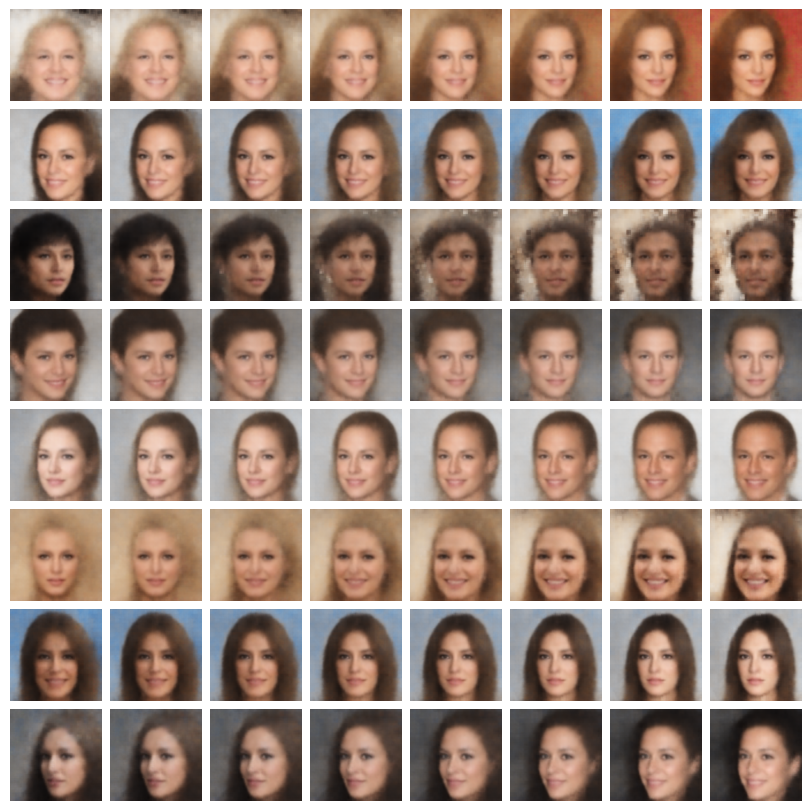

In [19]:
numlines = 8
points_per_line = 8
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model.eval()
with torch.no_grad():
    generated_imgs = model.decoder(pivots_walk.cuda(1))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [21]:
numlines = 10
points_per_line = 10
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model.eval()
with torch.no_grad():
    generated_imgs = model.decoder(pivots_walk.cuda(1))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
 
loader = torch.utils.data.DataLoader(dataset, batch_size=100, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

torch.Size([100, 20])
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 124ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 114ms/step
FID (100 images) : 39.436153411865234


## AE_celeba_160_15d

In [14]:
class Encoder(nn.Module):
    """The encoder for VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=0.25):
        super().__init__()
        
        convs = []
        prev_dim = input_dim
        for conv_dim in conv_dims:
            convs.append(nn.Sequential(
                nn.Conv2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.convs = nn.Sequential(*convs)
        self.do = nn.Dropout(p=dropout)
        prev_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(prev_dim, fc_dim),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(fc_dim, latent_dim)
        self.fc_log_var = nn.Linear(fc_dim, latent_dim)
                    
    def forward(self, x):
        x = self.do(self.convs(x))
        x = torch.flatten(x, start_dim=1)
        x = self.fc(x)
        mu = self.fc_mu(x)
        return mu
    
class Decoder(nn.Module):
    """The decoder for VAE"""
    
    def __init__(self, latent_dim, image_size, conv_dims, output_dim):
        super().__init__()
        
        fc_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, fc_dim),
            nn.ReLU()
        )
        self.conv_size1 = self.conv_size2 = image_size // (2 ** len(conv_dims))
        
        de_convs = []
        prev_dim = conv_dims[-1]
        for conv_dim in conv_dims[::-1]:
            de_convs.append(nn.Sequential(
                nn.ConvTranspose2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.de_convs = nn.Sequential(*de_convs)
        self.pred_layer = nn.Sequential(
            nn.Conv2d(prev_dim, output_dim, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.fc(x)
        x = x.reshape(x.size(0), -1, self.conv_size1, self.conv_size2)
        x = self.de_convs(x)
        x = self.pred_layer(x)
        return x

class VAE(nn.Module):
    """VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout):
        super().__init__()
        
        self.encoder = Encoder(image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=dropout)
        self.decoder = Decoder(latent_dim, image_size, conv_dims, input_dim)
        
    def sample_z(self, mu, log_var):
        """sample z by reparameterization trick"""
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
    
    def forward(self, x):
        mu = self.encoder(x)
        recon = self.decoder(mu)
        return recon
    
    def compute_loss(self, x, recon):
        """compute loss of VAE"""
        
        # recon loss
        x = x.clip(max=1., min=0.)
        recon_loss = F.binary_cross_entropy(recon, x, reduction="none").sum([1, 2, 3]).mean()
        
        return recon_loss

In [15]:
model2 = VAE(160, 3, [64, 128, 256], 120, 15, dropout=0)
model2 = torch.load('ae_celeba160/modelFinal.pt')
device = next(model2.parameters()).device
sum([p.numel() for p in model2.parameters()]), next(model2.parameters()).device

(8062817, device(type='cuda', index=0))

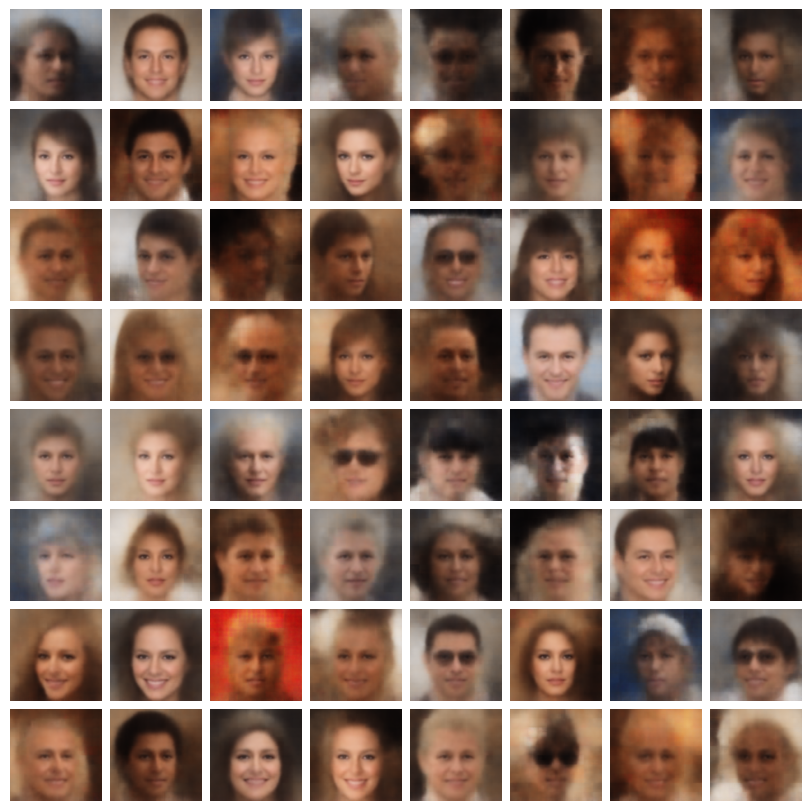

In [16]:
n_cols, n_rows = 8, 8
sample_zs = torch.randn(n_cols * n_rows, 15)
model2.eval()
with torch.no_grad(): 
    generated_imgs = model2.decoder(sample_zs.to(device))
    generated_imgs = generated_imgs.cpu().numpy()
generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(n_rows, n_cols, 3, 160,160)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(n_rows, n_cols)
for n_col in range(n_cols):
    for n_row in range(n_rows):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [18]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 326ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 292ms/step
FID (64 images) : 55.75102233886719


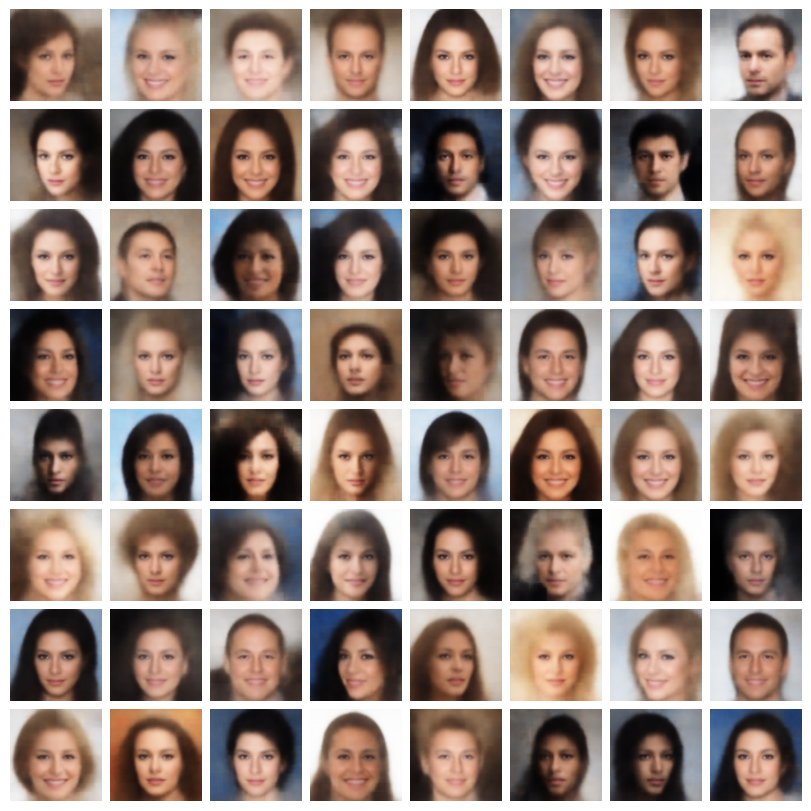

In [19]:
# sampling from N(mu, sigma)
import scipy

transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
model2.eval()
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
with torch.no_grad() : pivots = model2.encoder(next(iter(loader)).cuda()).cpu()
mu = pivots.mean(dim=0, keepdims=True)
sigma = scipy.linalg.sqrtm(pivots.transpose(0,1).cov()).real
sample_zs = (mu + torch.randn(64, 15)@sigma).to(device)
with torch.no_grad():
    generated_imgs = model2.decoder(sample_zs)
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")

In [20]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 292ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 338ms/step
FID (64 images) : 51.225868225097656


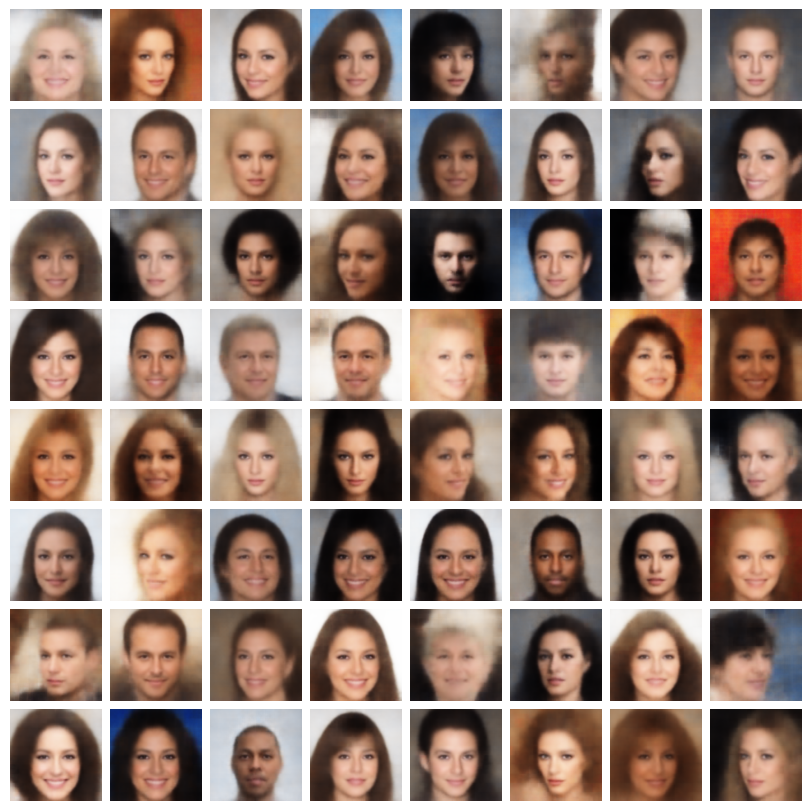

In [21]:
# baseline : reconstructions
with torch.no_grad() :
    recons = model2.decoder(pivots.cuda()).cpu()
recons = np.array(recons * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(recons[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [22]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, recons.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 281ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 253ms/step
FID (64 images) : 49.85791778564453


torch.Size([64, 15])


  0%|          | 0/35000 [00:00<?, ?it/s]

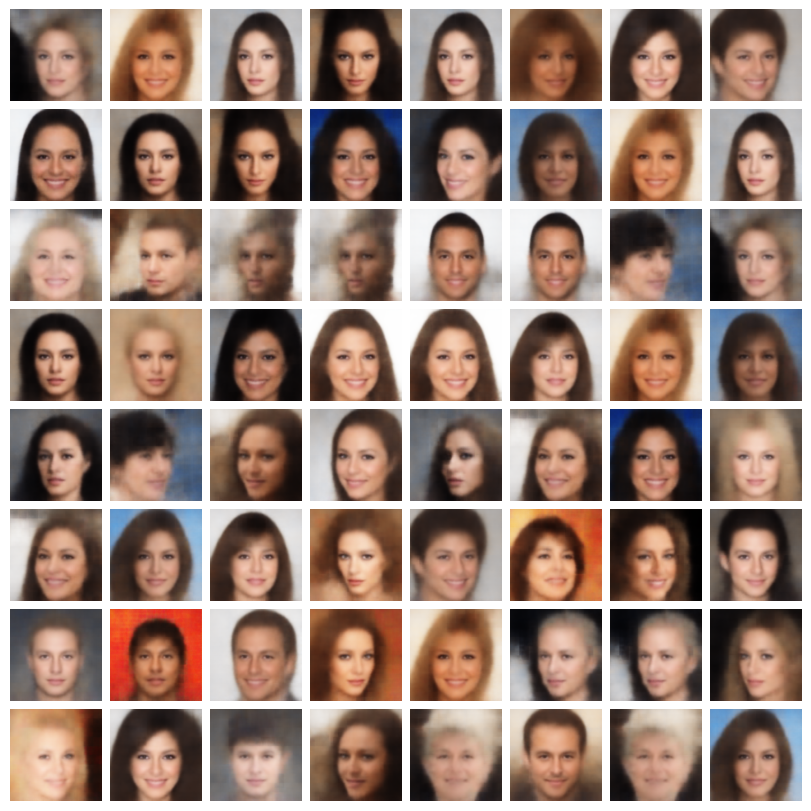

In [18]:
## sampling from langevin MC

#### HPARAMS ####
GAUSE_STD = 1
STEP = 1 
WEIGHT = 1
K = 50
#################

def potential(z, encodings, sigma=GAUSE_STD, pot=True) :
    z = z.view(-1, 1, encodings.shape[-1])
    ans = 0
    ans = torch.exp(-torch.norm(z-encodings, dim=-1)**2 / (2*sigma*sigma)).max(-1).values
    if pot : return -torch.log(ans)
    return ans

def log_Q(potential, encodings, z_prime, z, step):
    z.requires_grad_()
    grad = torch.autograd.grad(potential(z, encodings).mean(), z)[0]
    return -(torch.norm(z_prime - z + step * grad, p=2, dim=1) ** 2) / (4 * step)

def metropolis_adjusted_langevin_algorithm(potential, encodings, n_samples=100000, step=0.001, k=50, use_conf=False):
    burn_in = 10000
    weight = WEIGHT
    Z0 = torch.randn(1, encodings.shape[-1])
    THRESH = 0.3; c=0; p=1
    Zi = Z0
    samples = []
    returnable = []
    sample_conf = []
    log_ratios = []
    grads = []
    acc = []
    steps = []
    pbar = tqdm(range(k*n_samples + burn_in)) if not use_conf else tqdm(range(burn_in))
    for _ in pbar :
        Zi.requires_grad_()
        u = potential(Zi, encodings).mean()
        grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
        st_one = -step *grad
        st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
        with torch.no_grad() : 
            if potential(Zi, encodings, pot=False) < 0.9 : st = st_one
            else : st = st_two
        prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
        log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                    log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
        log_ratios.append(log_ratio.detach().item())
        if True : # torch.rand(1) < torch.exp(log_ratio):
            Zi = prop_Zi; acc.append(1)
        else : acc.append(0)
        samples.append(Zi.detach().numpy())
        sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
    if use_conf :
        print('Now Sampling...')
        while True :
            Zi.requires_grad_()
            u = potential(Zi, encodings).mean()
            grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
            st_one = -step*grad
            st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
            with torch.no_grad() : 
                if potential(Zi, encodings, pot=False) <0.9 : st = st_one
                else : st = st_two
            # st = st_one + st_two # 3*st_one/st_one.norm() + 3*st_two/st_two.norm()
            # st /= st.norm()
            prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
            log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                        log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
            log_ratios.append(log_ratio.detach().item())
            if torch.rand(1) < torch.exp(log_ratio):
                Zi = prop_Zi; acc.append(1)
            else : acc.append(0)
            if potential(Zi.detach(), encodings, pot=False)>=THRESH : returnable.append(Zi.detach().numpy()); c+=1; print(c, end=' : ')
            sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
            if c>=n_samples : break
        return np.concatenate(returnable, 0), grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
    return np.concatenate(samples, 0)[burn_in::k], grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
print(pivots.shape)
latents, grads, acc, burns, confs, steps, log_ratios = metropolis_adjusted_langevin_algorithm(potential, pivots, n_samples=500, k=K, step=STEP, use_conf=False) # change 64 to 1000 later

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(torch.tensor(latents, device='cuda:0'))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs[:64] * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [19]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
loader = torch.utils.data.DataLoader(dataset, batch_size=500, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

16/16 ━━━━━━━━━━━━━━━━━━━━ 4s 248ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 3s 174ms/step
FID (500 images) : 49.3656120300293


torch.Size([64, 15])


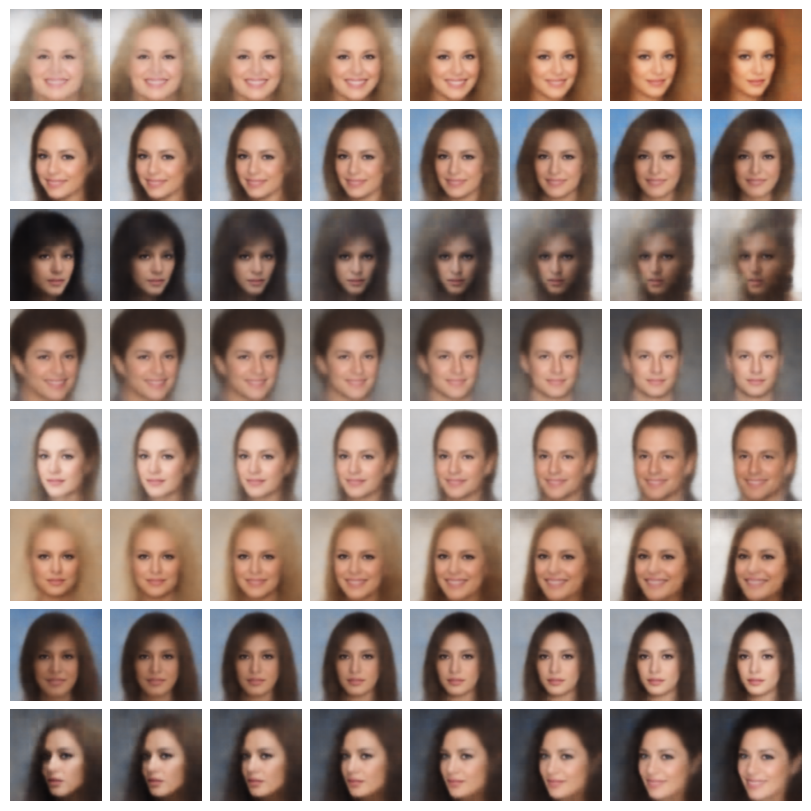

In [20]:
numlines = 8
points_per_line = 8
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(pivots_walk.cuda())
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [21]:
numlines = 10
points_per_line = 10
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(pivots_walk.cuda())
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
 
loader = torch.utils.data.DataLoader(dataset, batch_size=100, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

torch.Size([100, 15])
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 125ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 114ms/step
FID (100 images) : 53.223846435546875


In [50]:
with torch.no_grad() :
    vertices = model2.decoder(pivots[1:4].cuda()).cpu()
    centroid = model2.decoder(pivots[1:4].mean(dim=0, keepdims=True).cuda()).cpu()

([], [])

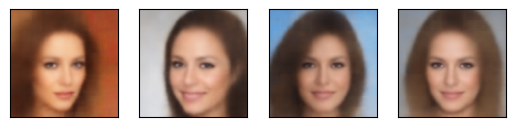

In [54]:
plt.subplot(1,4,1)
plt.imshow(vertices[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,2)
plt.imshow(vertices[1].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,3)
plt.imshow(vertices[2].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,4)
plt.imshow(centroid[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])

([], [])

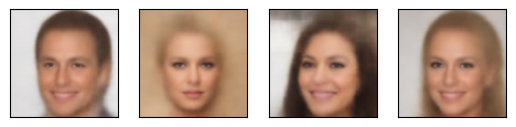

In [56]:
with torch.no_grad() :
    vertices = model2.decoder(pivots[9:12].cuda()).cpu()
    centroid = model2.decoder(pivots[9:12].mean(dim=0, keepdims=True).cuda()).cpu()

plt.subplot(1,4,1)
plt.imshow(vertices[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,2)
plt.imshow(vertices[1].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,3)
plt.imshow(vertices[2].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,4)
plt.imshow(centroid[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])

## AE_celeba_160_20d

In [6]:
class Encoder(nn.Module):
    """The encoder for VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=0.25):
        super().__init__()
        
        convs = []
        prev_dim = input_dim
        for conv_dim in conv_dims:
            convs.append(nn.Sequential(
                nn.Conv2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.convs = nn.Sequential(*convs)
        self.do = nn.Dropout(p=dropout)
        prev_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(prev_dim, fc_dim),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(fc_dim, latent_dim)
        self.fc_log_var = nn.Linear(fc_dim, latent_dim)
                    
    def forward(self, x):
        x = self.do(self.convs(x))
        x = torch.flatten(x, start_dim=1)
        x = self.fc(x)
        mu = self.fc_mu(x)
        return mu
    
class Decoder(nn.Module):
    """The decoder for VAE"""
    
    def __init__(self, latent_dim, image_size, conv_dims, output_dim):
        super().__init__()
        
        fc_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, fc_dim),
            nn.ReLU()
        )
        self.conv_size1 = self.conv_size2 = image_size // (2 ** len(conv_dims))
        
        de_convs = []
        prev_dim = conv_dims[-1]
        for conv_dim in conv_dims[::-1]:
            de_convs.append(nn.Sequential(
                nn.ConvTranspose2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.de_convs = nn.Sequential(*de_convs)
        self.pred_layer = nn.Sequential(
            nn.Conv2d(prev_dim, output_dim, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.fc(x)
        x = x.reshape(x.size(0), -1, self.conv_size1, self.conv_size2)
        x = self.de_convs(x)
        x = self.pred_layer(x)
        return x

class VAE(nn.Module):
    """VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout):
        super().__init__()
        
        self.encoder = Encoder(image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=dropout)
        self.decoder = Decoder(latent_dim, image_size, conv_dims, input_dim)
        
    def sample_z(self, mu, log_var):
        """sample z by reparameterization trick"""
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
    
    def forward(self, x):
        mu = self.encoder(x)
        recon = self.decoder(mu)
        return recon
    
    def compute_loss(self, x, recon):
        """compute loss of VAE"""
        
        # recon loss
        x = x.clip(max=1., min=0.)
        recon_loss = F.binary_cross_entropy(recon, x, reduction="none").sum([1, 2, 3]).mean()
        
        return recon_loss

In [7]:
model2 = VAE(160, 3, [64, 128, 256], 120, 20, dropout=0)
model2 = torch.load('ae_celeba160_20d/modelFinal.pt')
device = next(model2.parameters()).device
sum([p.numel() for p in model2.parameters()]), next(model2.parameters()).device

(108381483, device(type='cuda', index=0))

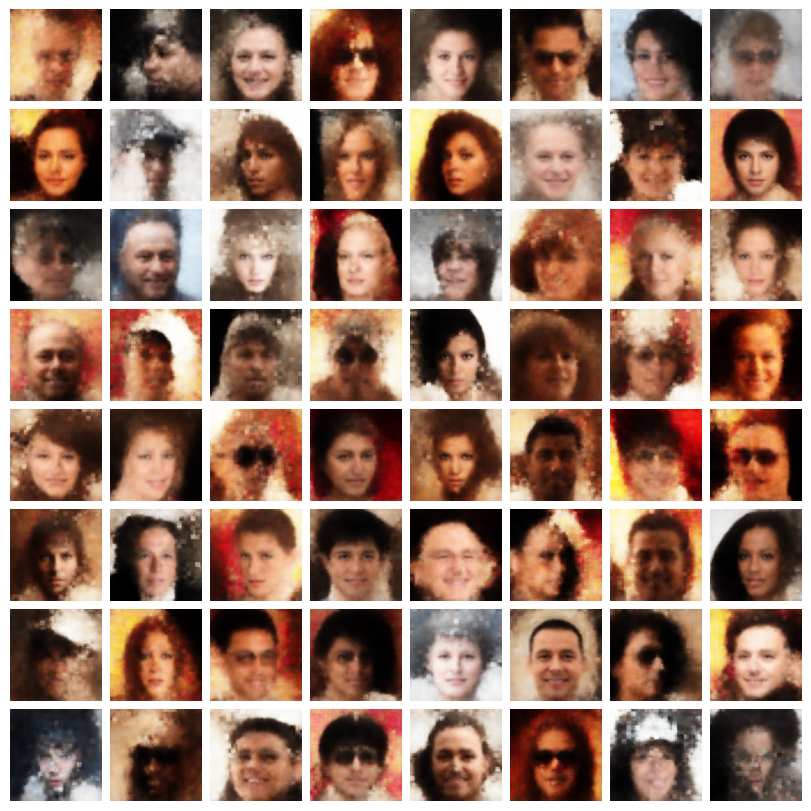

In [10]:
n_cols, n_rows = 8, 8
sample_zs = torch.randn(n_cols * n_rows, 20)
model2.eval()
with torch.no_grad(): 
    generated_imgs = model2.decoder(sample_zs.to(device))
    generated_imgs = generated_imgs.cpu().numpy()
generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(n_rows, n_cols, 3, 160,160)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(n_rows, n_cols)
for n_col in range(n_cols):
    for n_row in range(n_rows):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [11]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
FID (64 images) : 57.91431427001953


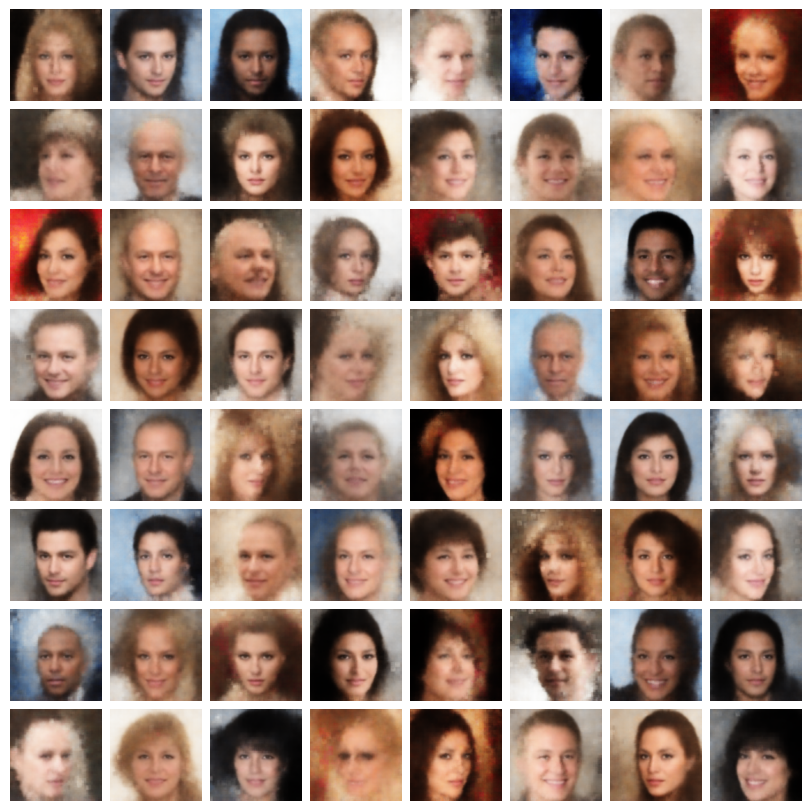

In [25]:
# sampling from N(mu, sigma)
import scipy

transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
model2.eval()
loader = torch.utils.data.DataLoader(dataset, batch_size=256, shuffle=False)
with torch.no_grad() : pivots = model2.encoder(next(iter(loader)).cuda()).cpu()
mu = pivots.mean(dim=0, keepdims=True)
sigma = scipy.linalg.sqrtm(pivots.transpose(0,1).cov()).real
sample_zs = (mu + torch.randn(64, 20)@sigma).to(device)
with torch.no_grad():
    generated_imgs = model2.decoder(sample_zs)
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")

In [26]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
FID (64 images) : 51.17232131958008


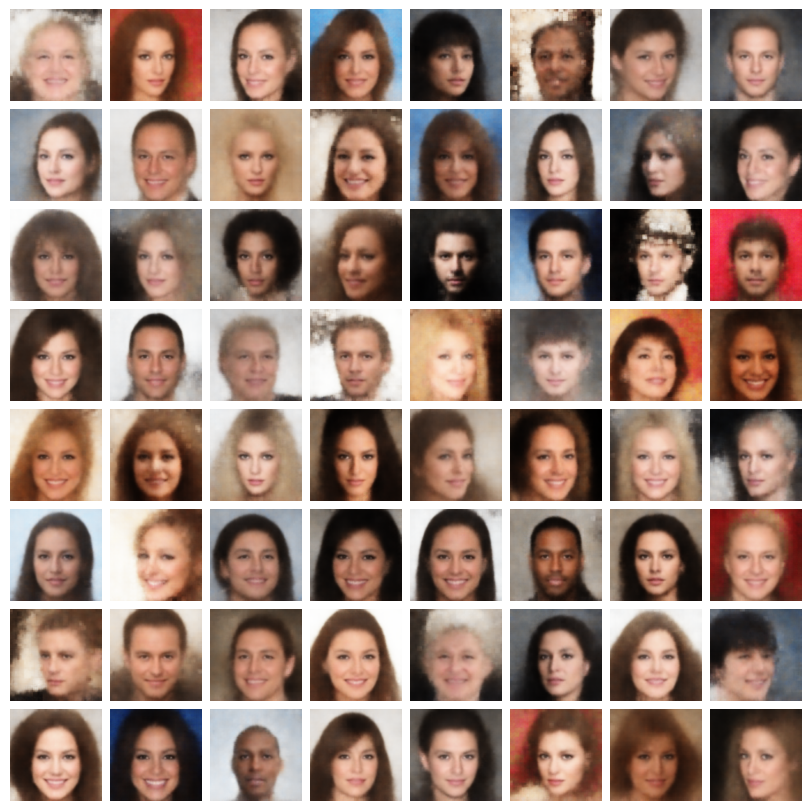

In [28]:
# baseline : reconstructions
with torch.no_grad() :
    recons = model2.decoder(pivots.cuda()).cpu()[:64]
recons = np.array(recons * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(recons[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [29]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, recons.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
FID (64 images) : 41.704559326171875


torch.Size([256, 20])


  0%|          | 0/7400 [00:00<?, ?it/s]

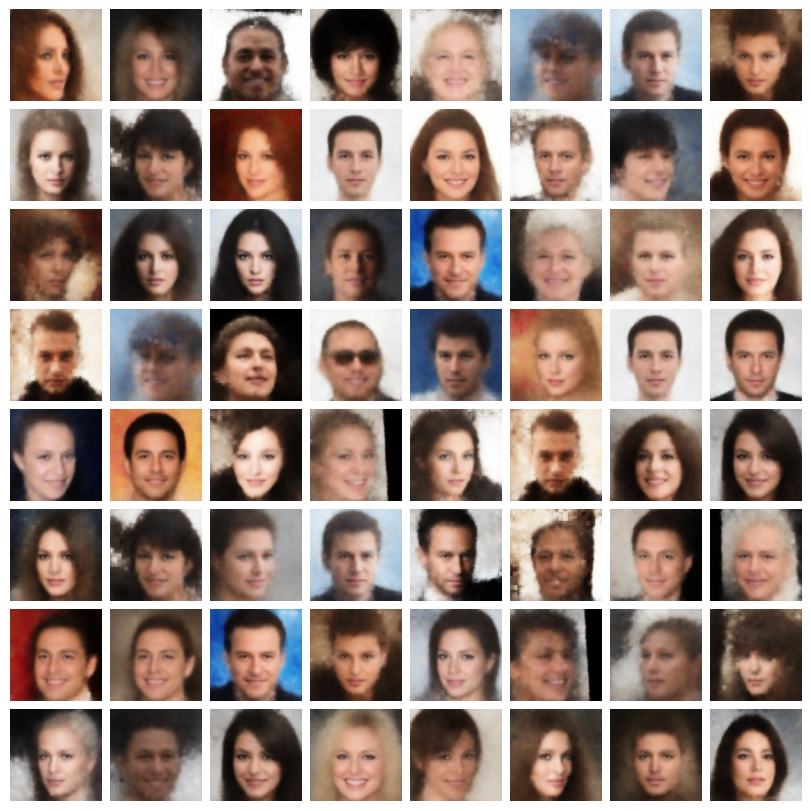

In [30]:
## sampling from langevin MC

#### HPARAMS ####
GAUSE_STD = 1
STEP = 1 
WEIGHT = 1
K = 100
#################

def potential(z, encodings, sigma=GAUSE_STD, pot=True) :
    z = z.view(-1, 1, encodings.shape[-1])
    ans = 0
    ans = torch.exp(-torch.norm(z-encodings, dim=-1)**2 / (2*sigma*sigma)).max(-1).values
    if pot : return -torch.log(ans)
    return ans

def log_Q(potential, encodings, z_prime, z, step):
    z.requires_grad_()
    grad = torch.autograd.grad(potential(z, encodings).mean(), z)[0]
    return -(torch.norm(z_prime - z + step * grad, p=2, dim=1) ** 2) / (4 * step)

def metropolis_adjusted_langevin_algorithm(potential, encodings, n_samples=100000, step=0.001, k=50, use_conf=False):
    burn_in = 1000 # 10000
    weight = WEIGHT
    Z0 = torch.randn(1, encodings.shape[-1])
    THRESH = 0.3; c=0; p=1
    Zi = Z0
    samples = []
    returnable = []
    sample_conf = []
    log_ratios = []
    grads = []
    acc = []
    steps = []
    pbar = tqdm(range(k*n_samples + burn_in)) if not use_conf else tqdm(range(burn_in))
    for _ in pbar :
        Zi.requires_grad_()
        u = potential(Zi, encodings).mean()
        grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
        st_one = -step *grad
        st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
        with torch.no_grad() : 
            if potential(Zi, encodings, pot=False) < 0.9 : st = st_one
            else : st = st_two
        prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
        log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                    log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
        log_ratios.append(log_ratio.detach().item())
        if True : # torch.rand(1) < torch.exp(log_ratio):
            Zi = prop_Zi; acc.append(1)
        else : acc.append(0)
        samples.append(Zi.detach().numpy())
        sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
    if use_conf :
        print('Now Sampling...')
        while True :
            Zi.requires_grad_()
            u = potential(Zi, encodings).mean()
            grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
            st_one = -step*grad
            st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
            with torch.no_grad() : 
                if potential(Zi, encodings, pot=False) <0.9 : st = st_one
                else : st = st_two
            # st = st_one + st_two # 3*st_one/st_one.norm() + 3*st_two/st_two.norm()
            # st /= st.norm()
            prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
            log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                        log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
            log_ratios.append(log_ratio.detach().item())
            if torch.rand(1) < torch.exp(log_ratio):
                Zi = prop_Zi; acc.append(1)
            else : acc.append(0)
            if potential(Zi.detach(), encodings, pot=False)>=THRESH : returnable.append(Zi.detach().numpy()); c+=1; print(c, end=' : ')
            sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
            if c>=n_samples : break
        return np.concatenate(returnable, 0), grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
    return np.concatenate(samples, 0)[burn_in::k], grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
print(pivots.shape)
latents, grads, acc, burns, confs, steps, log_ratios = metropolis_adjusted_langevin_algorithm(potential, pivots, n_samples=64, k=K, step=STEP, use_conf=False) # change 64 to 1000 later

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(torch.tensor(latents, device='cuda:0'))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs[:64] * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [31]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
FID (64 images) : 50.49114990234375


torch.Size([64, 20])


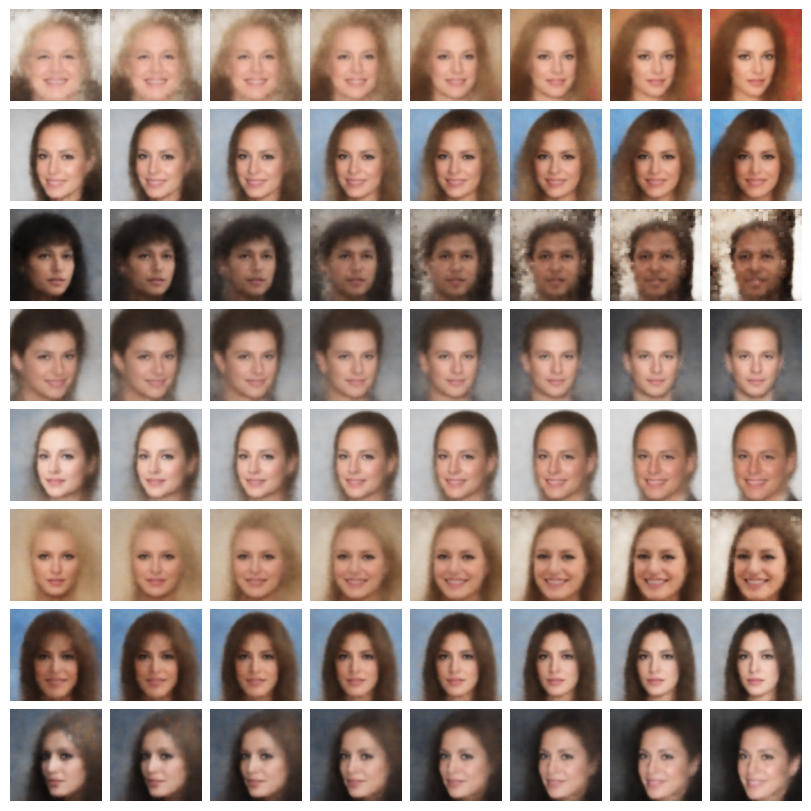

In [32]:
numlines = 8
points_per_line = 8
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(pivots_walk.cuda())
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [34]:
numlines = 8
points_per_line = 8
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(pivots_walk.cuda())
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
 
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

torch.Size([64, 20])
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
FID (64 images) : 32.09342956542969


([], [])

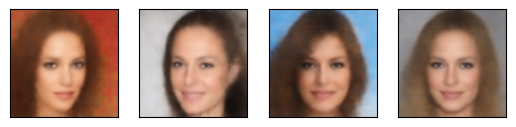

In [18]:
with torch.no_grad() :
    vertices = model2.decoder(pivots[1:4].cuda()).cpu()
    centroid = model2.decoder(pivots[1:4].mean(dim=0, keepdims=True).cuda()).cpu()

plt.subplot(1,4,1)
plt.imshow(vertices[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,2)
plt.imshow(vertices[1].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,3)
plt.imshow(vertices[2].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,4)
plt.imshow(centroid[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])

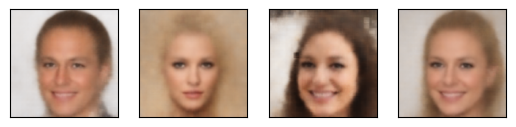

In [20]:
with torch.no_grad() :
    vertices = model2.decoder(pivots[9:12].cuda()).cpu()
    centroid = model2.decoder(pivots[9:12].mean(dim=0, keepdims=True).cuda()).cpu()

plt.subplot(1,4,1)
plt.imshow(vertices[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,2)
plt.imshow(vertices[1].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,3)
plt.imshow(vertices[2].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,4)
plt.imshow(centroid[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([]);

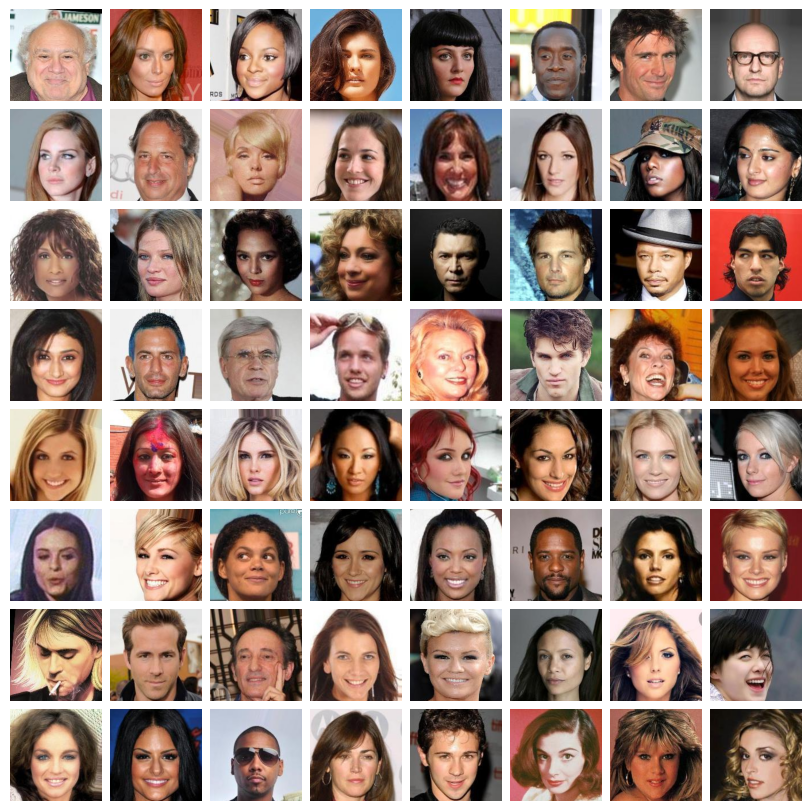

In [25]:
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(dataset[8*n_row + n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

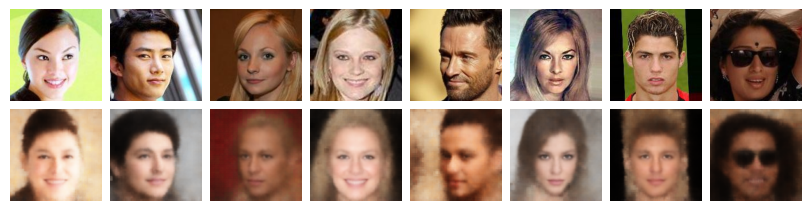

In [13]:
temp_loader = torch.utils.data.DataLoader(dataset, batch_size=8, shuffle=True)
data = next(iter(temp_loader))
with torch.no_grad() :
    encodings = model2.encoder(data.cuda()).cpu()
    temp = model2.decoder(encodings.cuda()).cpu()

fig = plt.figure(figsize=(8, 2), constrained_layout=True)
gs = fig.add_gridspec(2, 8)
for n_col in range(8):
    f_ax = fig.add_subplot(gs[0, n_col])
    f_ax.imshow(data[n_col].swapaxes(0,1).swapaxes(1,2))
    f_ax.axis("off")
for n_col in range(8):
    f_ax = fig.add_subplot(gs[1, n_col])
    f_ax.imshow(temp[n_col].swapaxes(0,1).swapaxes(1,2))
    f_ax.axis("off")
plt.show()

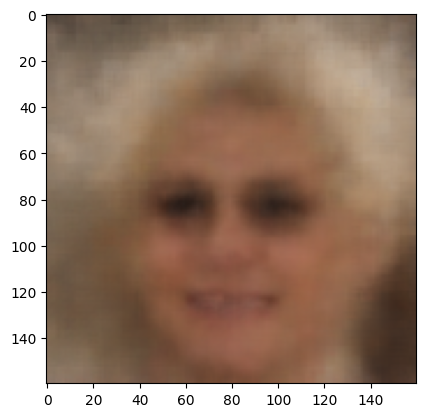

In [73]:
temp = 0.4*encodings[1] + 0.6*encodings[4]
with torch.no_grad() : exp = model2.decoder(temp.unsqueeze(0).cuda()).cpu()

plt.imshow(exp[0].swapaxes(0,1).swapaxes(1,2))

torch.Size([1, 8, 20]) torch.Size([8, 3, 160, 160])


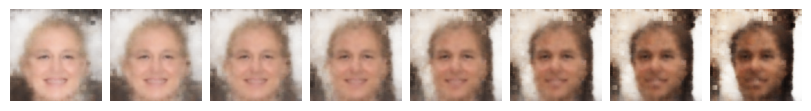

In [43]:
with torch.no_grad() :
    one = model2.encoder(dataset[0].unsqueeze(0).cuda()).cpu()
    two = model2.encoder(dataset[5].unsqueeze(0).cuda()).cpu()
pivots_walk = one + torch.linspace(0, 1, 8)[:,None]*(two-one)[None,:]
with torch.no_grad() :
    images = model2.decoder(pivots_walk.squeeze().cuda()).cpu()
print(pivots_walk.shape, images.shape)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    f_ax = fig.add_subplot(gs[0, n_col])
    f_ax.imshow(images[n_col].swapaxes(0,1).swapaxes(1,2))
    f_ax.axis("off")
plt.show()

## AE_celeba_160_100d

In [7]:
class Encoder(nn.Module):
    """The encoder for VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=0.25):
        super().__init__()
        
        convs = []
        prev_dim = input_dim
        for conv_dim in conv_dims:
            convs.append(nn.Sequential(
                nn.Conv2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.convs = nn.Sequential(*convs)
        self.do = nn.Dropout(p=dropout)
        prev_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(prev_dim, fc_dim),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(fc_dim, latent_dim)
        self.fc_log_var = nn.Linear(fc_dim, latent_dim)
                    
    def forward(self, x):
        x = self.do(self.convs(x))
        x = torch.flatten(x, start_dim=1)
        x = self.fc(x)
        mu = self.fc_mu(x)
        return mu
    
class Decoder(nn.Module):
    """The decoder for VAE"""
    
    def __init__(self, latent_dim, image_size, conv_dims, output_dim):
        super().__init__()
        
        fc_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, fc_dim),
            nn.ReLU()
        )
        self.conv_size1 = self.conv_size2 = image_size // (2 ** len(conv_dims))
        
        de_convs = []
        prev_dim = conv_dims[-1]
        for conv_dim in conv_dims[::-1]:
            de_convs.append(nn.Sequential(
                nn.ConvTranspose2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.de_convs = nn.Sequential(*de_convs)
        self.pred_layer = nn.Sequential(
            nn.Conv2d(prev_dim, output_dim, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.fc(x)
        x = x.reshape(x.size(0), -1, self.conv_size1, self.conv_size2)
        x = self.de_convs(x)
        x = self.pred_layer(x)
        return x

class VAE(nn.Module):
    """VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout):
        super().__init__()
        
        self.encoder = Encoder(image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=dropout)
        self.decoder = Decoder(latent_dim, image_size, conv_dims, input_dim)
        
    def sample_z(self, mu, log_var):
        """sample z by reparameterization trick"""
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
    
    def forward(self, x):
        mu = self.encoder(x)
        recon = self.decoder(mu)
        return recon
    
    def compute_loss(self, x, recon):
        """compute loss of VAE"""
        
        # recon loss
        x = x.clip(max=1., min=0.)
        recon_loss = F.binary_cross_entropy(recon, x, reduction="none").sum([1, 2, 3]).mean()
        
        return recon_loss

In [8]:
latent_dim = 100
model2 = VAE(160, 3, [64, 128, 256], 1024, latent_dim, dropout=0)
model2 = torch.load('Experiments/ae_celeba160_100d/modelFinal.pt')
device = next(model2.parameters()).device
sum([p.numel() for p in model2.parameters()]), next(model2.parameters()).device

(116737483, device(type='cuda', index=0))

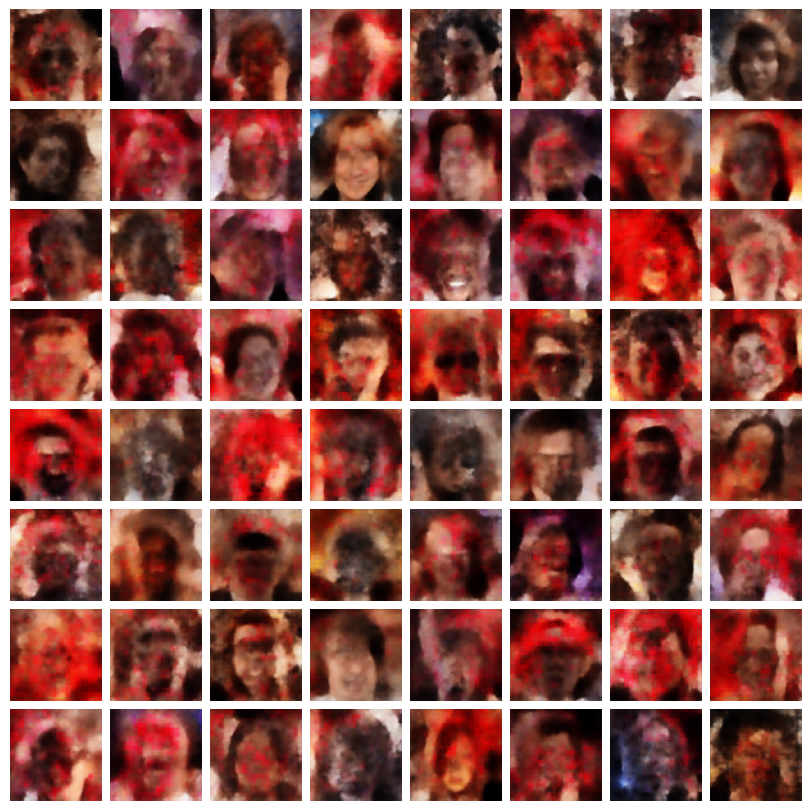

In [9]:
n_cols, n_rows = 8, 8
sample_zs = torch.randn(n_cols * n_rows, latent_dim)
model2.eval()
with torch.no_grad(): 
    generated_imgs = model2.decoder(sample_zs.to(device))
    generated_imgs = generated_imgs.cpu().numpy()
generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(n_rows, n_cols, 3, 160,160)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(n_rows, n_cols)
for n_col in range(n_cols):
    for n_row in range(n_rows):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [10]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 167ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
FID (64 images) : 85.75973510742188


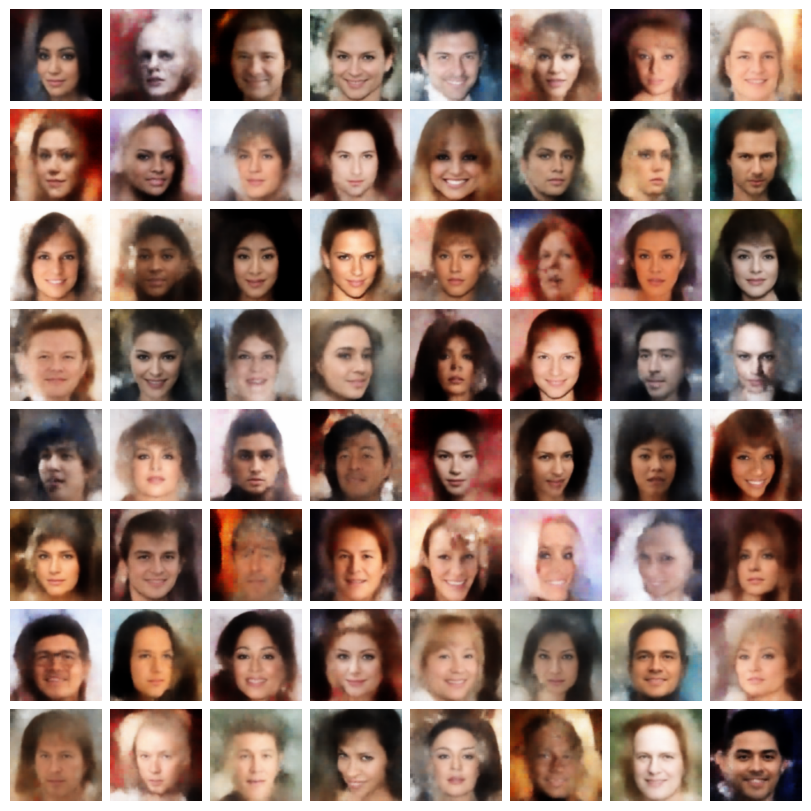

In [11]:
# sampling from N(mu, sigma)
import scipy

transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
model2.eval()
loader = torch.utils.data.DataLoader(dataset, batch_size=256, shuffle=False)
with torch.no_grad() : pivots = model2.encoder(next(iter(loader)).cuda()).cpu()
mu = pivots.mean(dim=0, keepdims=True)
sigma = scipy.linalg.sqrtm(pivots.transpose(0,1).cov()).real
sample_zs = (mu + torch.randn(64, latent_dim)@sigma).to(device)
with torch.no_grad():
    generated_imgs = model2.decoder(sample_zs)
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")

In [12]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step
FID (64 images) : 36.851295471191406


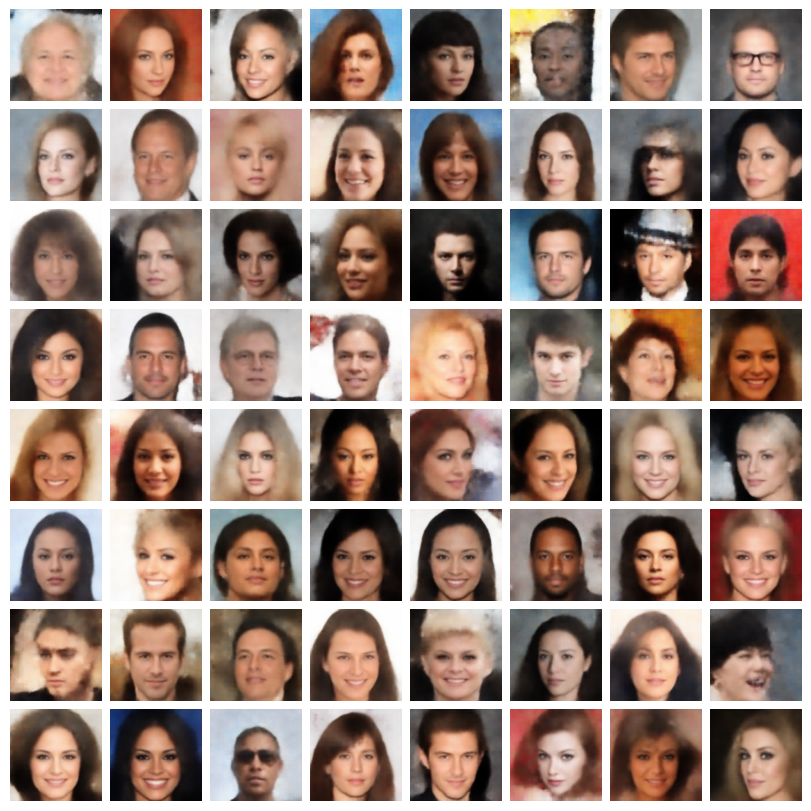

In [13]:
# baseline : reconstructions
with torch.no_grad() :
    recons = model2.decoder(pivots.cuda()).cpu()[:64]
recons = np.array(recons * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(recons[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [14]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, recons.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
FID (64 images) : 25.277231216430664


torch.Size([256, 100])


  0%|          | 0/7400 [00:00<?, ?it/s]

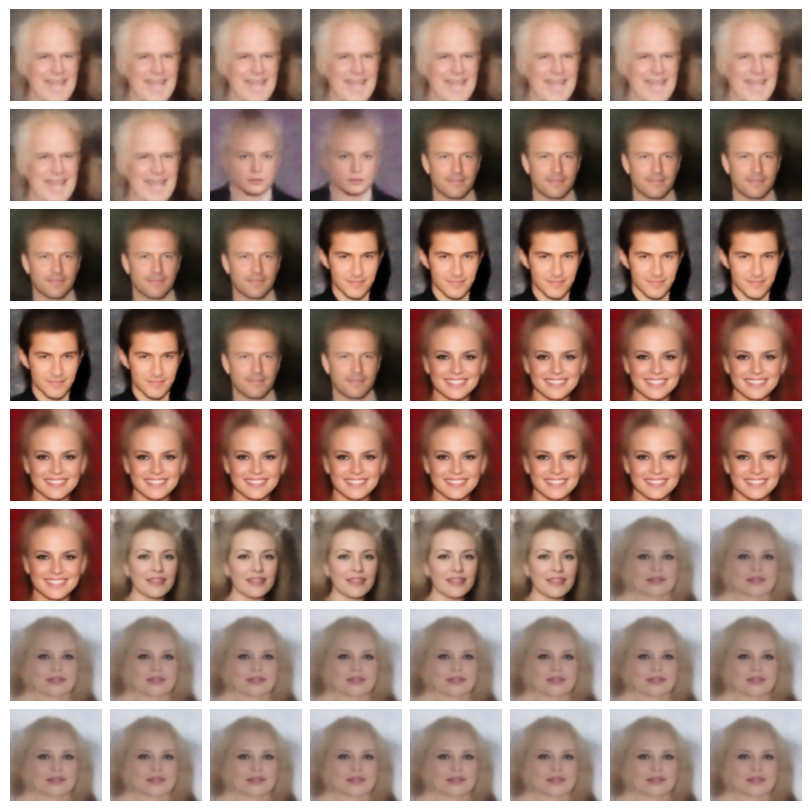

In [15]:
## sampling from langevin MC

#### HPARAMS ####
GAUSE_STD = 1
STEP = 1 
WEIGHT = 0.7
K = 100
#################

def potential(z, encodings, sigma=GAUSE_STD, pot=True) :
    z = z.view(-1, 1, encodings.shape[-1])
    ans = 0
    ans = torch.exp(-torch.norm(z-encodings, dim=-1)**2 / (2*sigma*sigma)).max(-1).values
    if pot : return -torch.log(ans)
    return ans

def log_Q(potential, encodings, z_prime, z, step):
    z.requires_grad_()
    grad = torch.autograd.grad(potential(z, encodings).mean(), z)[0]
    return -(torch.norm(z_prime - z + step * grad, p=2, dim=1) ** 2) / (4 * step)

def metropolis_adjusted_langevin_algorithm(potential, encodings, n_samples=100000, step=0.001, k=50, use_conf=False):
    burn_in = 1000 # 10000
    weight = WEIGHT
    Z0 = torch.randn(1, encodings.shape[-1])
    THRESH = 0.3; c=0; p=1
    Zi = Z0
    samples = []
    returnable = []
    sample_conf = []
    log_ratios = []
    grads = []
    acc = []
    steps = []
    pbar = tqdm(range(k*n_samples + burn_in)) if not use_conf else tqdm(range(burn_in))
    for _ in pbar :
        Zi.requires_grad_()
        u = potential(Zi, encodings).mean()
        grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
        st_one = -step *grad
        st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
        with torch.no_grad() : 
            if potential(Zi, encodings, pot=False) < 0.9 : st = st_one
            else : st = st_two
        prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
        log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                    log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
        log_ratios.append(log_ratio.detach().item())
        if True : # torch.rand(1) < torch.exp(log_ratio):
            Zi = prop_Zi; acc.append(1)
        else : acc.append(0)
        samples.append(Zi.detach().numpy())
        sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
    if use_conf :
        print('Now Sampling...')
        while True :
            Zi.requires_grad_()
            u = potential(Zi, encodings).mean()
            grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
            st_one = -step*grad
            st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
            with torch.no_grad() : 
                if potential(Zi, encodings, pot=False) <0.9 : st = st_one
                else : st = st_two
            # st = st_one + st_two # 3*st_one/st_one.norm() + 3*st_two/st_two.norm()
            # st /= st.norm()
            prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
            log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                        log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
            log_ratios.append(log_ratio.detach().item())
            if torch.rand(1) < torch.exp(log_ratio):
                Zi = prop_Zi; acc.append(1)
            else : acc.append(0)
            if potential(Zi.detach(), encodings, pot=False)>=THRESH : returnable.append(Zi.detach().numpy()); c+=1; print(c, end=' : ')
            sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
            if c>=n_samples : break
        return np.concatenate(returnable, 0), grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
    return np.concatenate(samples, 0)[burn_in::k], grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
print(pivots.shape)
latents, grads, acc, burns, confs, steps, log_ratios = metropolis_adjusted_langevin_algorithm(potential, pivots, n_samples=64, k=K, step=STEP, use_conf=False) # change 64 to 1000 later

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(torch.tensor(latents, device='cuda:0'))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs[:64] * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [16]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform, subset=64)
generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
FID (64 images) : 90.51698303222656


torch.Size([64, 100])


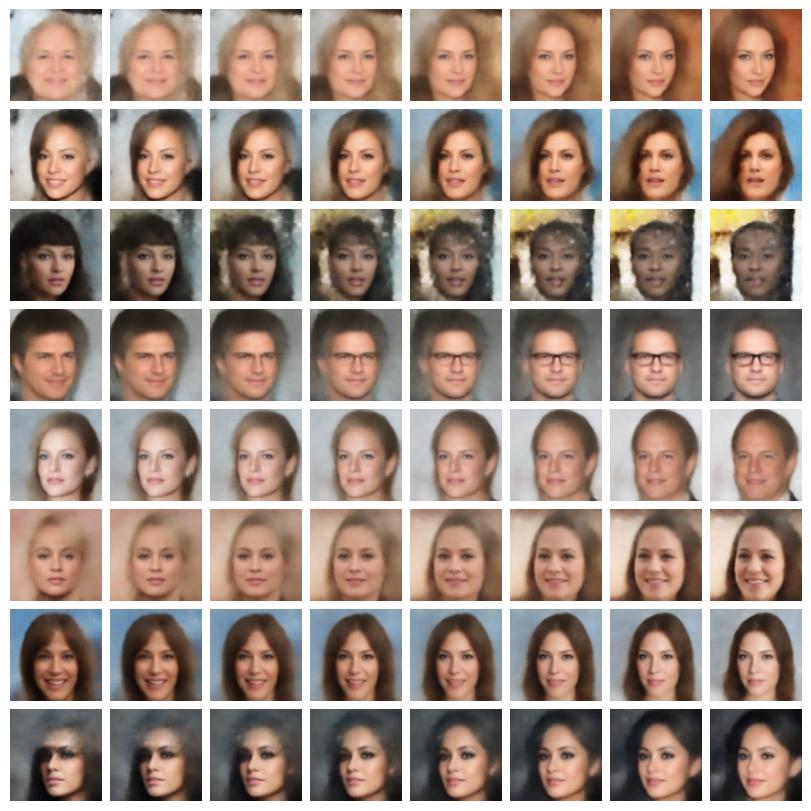

In [17]:
numlines = 8
points_per_line = 8
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(pivots_walk.cuda())
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [18]:
numlines = 8
points_per_line = 8
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model2.eval()
with torch.no_grad():
    generated_imgs = model2.decoder(pivots_walk.cuda())
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
 
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

torch.Size([64, 100])
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
FID (64 images) : 37.317291259765625


([], [])

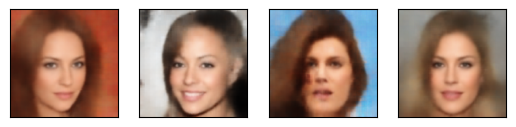

In [19]:
with torch.no_grad() :
    vertices = model2.decoder(pivots[1:4].cuda()).cpu()
    centroid = model2.decoder(pivots[1:4].mean(dim=0, keepdims=True).cuda()).cpu()

plt.subplot(1,4,1)
plt.imshow(vertices[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,2)
plt.imshow(vertices[1].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,3)
plt.imshow(vertices[2].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])
plt.subplot(1,4,4)
plt.imshow(centroid[0].swapaxes(0,1).swapaxes(1,2)); plt.xticks([]); plt.yticks([])

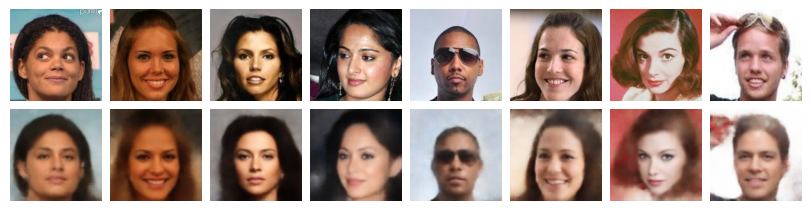

In [20]:
temp_loader = torch.utils.data.DataLoader(dataset, batch_size=8, shuffle=True)
data = next(iter(temp_loader))
with torch.no_grad() :
    encodings = model2.encoder(data.cuda()).cpu()
    temp = model2.decoder(encodings.cuda()).cpu()

fig = plt.figure(figsize=(8, 2), constrained_layout=True)
gs = fig.add_gridspec(2, 8)
for n_col in range(8):
    f_ax = fig.add_subplot(gs[0, n_col])
    f_ax.imshow(data[n_col].swapaxes(0,1).swapaxes(1,2))
    f_ax.axis("off")
for n_col in range(8):
    f_ax = fig.add_subplot(gs[1, n_col])
    f_ax.imshow(temp[n_col].swapaxes(0,1).swapaxes(1,2))
    f_ax.axis("off")
plt.show()

## VAE_celeba_160_100d

In [51]:
class Encoder(nn.Module):
    """The encoder for VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=0.25):
        super().__init__()
        
        convs = []
        prev_dim = input_dim
        for conv_dim in conv_dims:
            convs.append(nn.Sequential(
                nn.Conv2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.convs = nn.Sequential(*convs)
        self.do = nn.Dropout(p=dropout)
        prev_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(prev_dim, fc_dim),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(fc_dim, latent_dim)
        self.fc_log_var = nn.Linear(fc_dim, latent_dim)
                    
    def forward(self, x):
        x = self.do(self.convs(x))
        x = torch.flatten(x, start_dim=1)
        x = self.fc(x)
        mu = self.fc_mu(x)
        log_var = self.fc_log_var(x)
        return mu, log_var
    
class Decoder(nn.Module):
    """The decoder for VAE"""
    
    def __init__(self, latent_dim, image_size, conv_dims, output_dim):
        super().__init__()
        
        fc_dim = (image_size // (2 ** len(conv_dims))) ** 2 * conv_dims[-1]
        self.fc = nn.Sequential(
            nn.Linear(latent_dim, fc_dim),
            nn.ReLU()
        )
        self.conv_size1 = self.conv_size2 = image_size // (2 ** len(conv_dims))
        
        de_convs = []
        prev_dim = conv_dims[-1]
        for conv_dim in conv_dims[::-1]:
            de_convs.append(nn.Sequential(
                nn.ConvTranspose2d(prev_dim, conv_dim, kernel_size=3, stride=2, padding=1, output_padding=1),
                nn.ReLU()
            ))
            prev_dim = conv_dim
        self.de_convs = nn.Sequential(*de_convs)
        self.pred_layer = nn.Sequential(
            nn.Conv2d(prev_dim, output_dim, kernel_size=3, stride=1, padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.fc(x)
        x = x.reshape(x.size(0), -1, self.conv_size1, self.conv_size2)
        x = self.de_convs(x)
        x = self.pred_layer(x)
        return x

class VAE(nn.Module):
    """VAE"""
    
    def __init__(self, image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout):
        super().__init__()
        
        self.encoder = Encoder(image_size, input_dim, conv_dims, fc_dim, latent_dim, dropout=dropout)
        self.decoder = Decoder(latent_dim, image_size, conv_dims, input_dim)
        
    def sample_z(self, mu, log_var):
        """sample z by reparameterization trick"""
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
    
    def forward(self, x):
        mu, log_var = self.encoder(x)
        z = self.sample_z(mu, log_var)
        recon = self.decoder(z)
        return recon, mu, log_var
    
    def compute_loss(self, x, recon, mu, log_var):
        """compute loss of VAE"""
        
        # kl_loss
        kl_loss = (0.5*(log_var.exp() + mu ** 2 - 1 - log_var)).sum(1).mean()
        # recon loss
        x = x.clip(max=1., min=0.)
        recon_loss = F.binary_cross_entropy(recon, x, reduction="none").sum([1, 2, 3]).mean()
        
        return kl_loss + recon_loss

In [53]:
latent_dim = 100
model = VAE(160, 3, [64, 128, 256], 1024, 100, dropout=0)
model = torch.load('Experiments/vae_celeba160_100d/modelFinal.pt')
device = next(model.parameters()).device
sum([p.numel() for p in model.parameters()]), next(model.parameters()).device

(116737483, device(type='cuda', index=1))

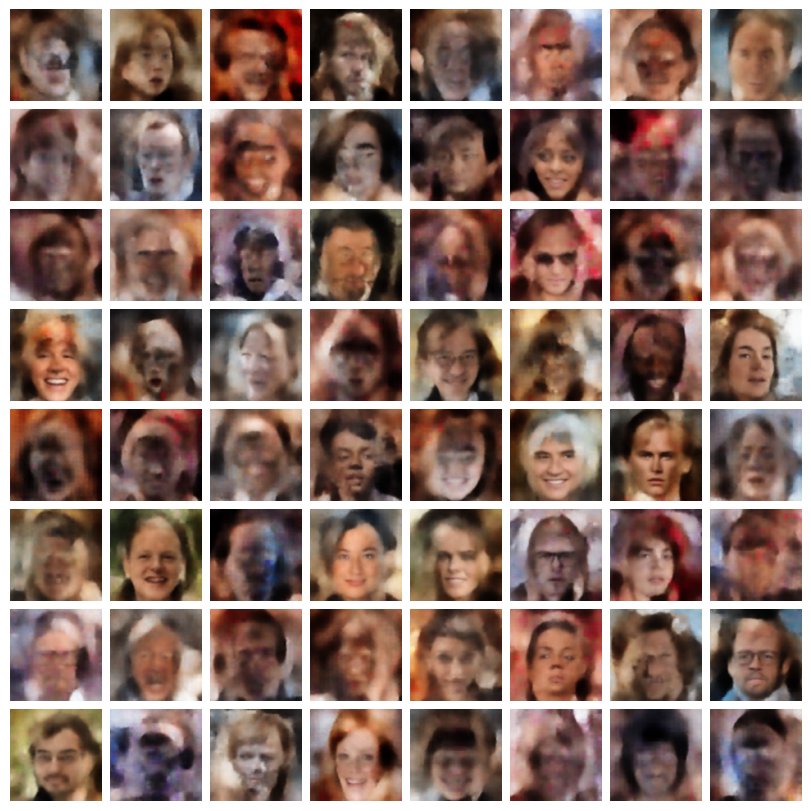

In [55]:
n_cols, n_rows = 8, 8
sample_zs = torch.randn(n_cols * n_rows, latent_dim)
model.eval()
with torch.no_grad(): 
    generated_imgs = model.decoder(sample_zs.to(device))
    generated_imgs = generated_imgs.cpu().numpy()
generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(n_rows, n_cols, 3, 160,160)

fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(n_rows, n_cols)
for n_col in range(n_cols):
    for n_row in range(n_rows):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [56]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
FID (64 images) : 44.55853271484375


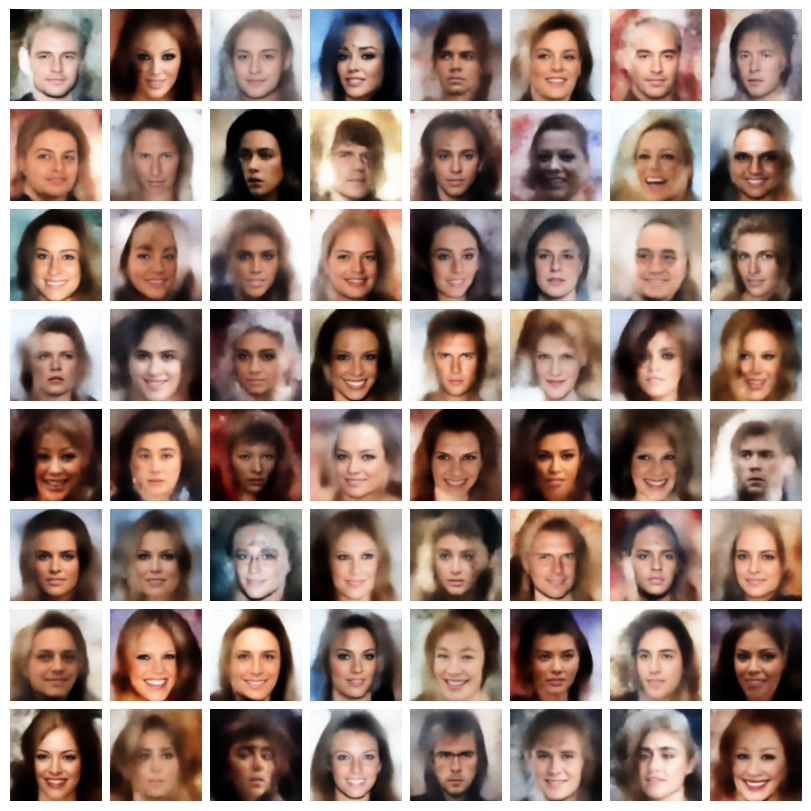

In [57]:
# sampling from N(mu, sigma)
import scipy

transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
model.eval()
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
with torch.no_grad() : pivots = model.encoder(next(iter(loader)).cuda(1))[0].cpu()
mu = pivots.mean(dim=0, keepdims=True)
sigma = scipy.linalg.sqrtm(pivots.transpose(0,1).cov()).real
sample_zs = (mu + torch.randn(64, latent_dim)@sigma).to('cuda:1')
with torch.no_grad():
    generated_imgs = model.decoder(sample_zs)
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")

In [58]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
FID (64 images) : 29.793975830078125


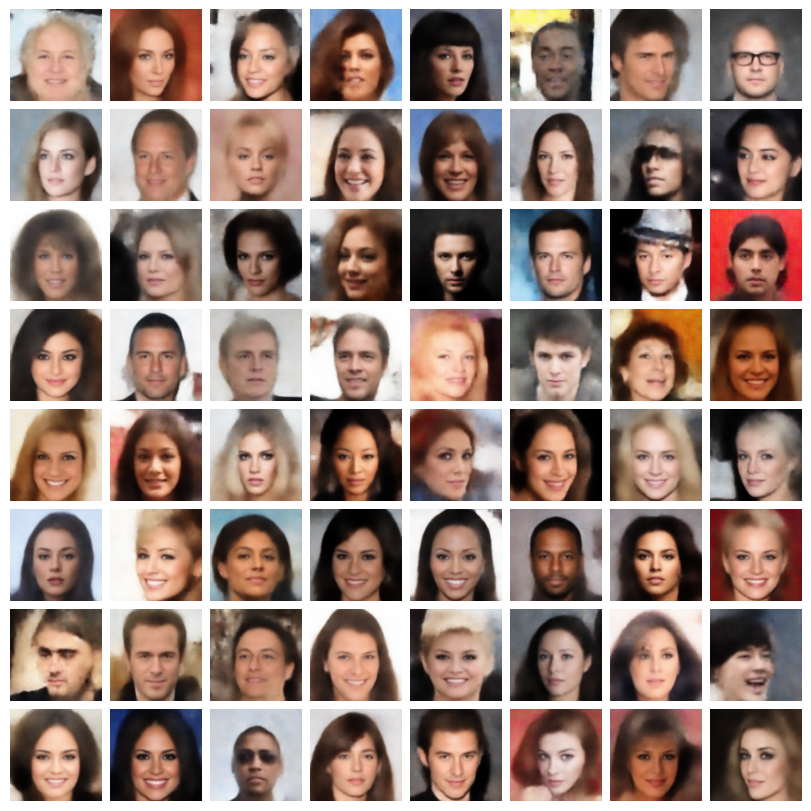

In [59]:
# baseline : reconstructions
with torch.no_grad() :
    recons = model.decoder(pivots.cuda(1)).cpu()
recons = np.array(recons * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(recons[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [60]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, recons.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
FID (64 images) : 18.817543029785156


torch.Size([64, 100])


  0%|          | 0/4200 [00:00<?, ?it/s]

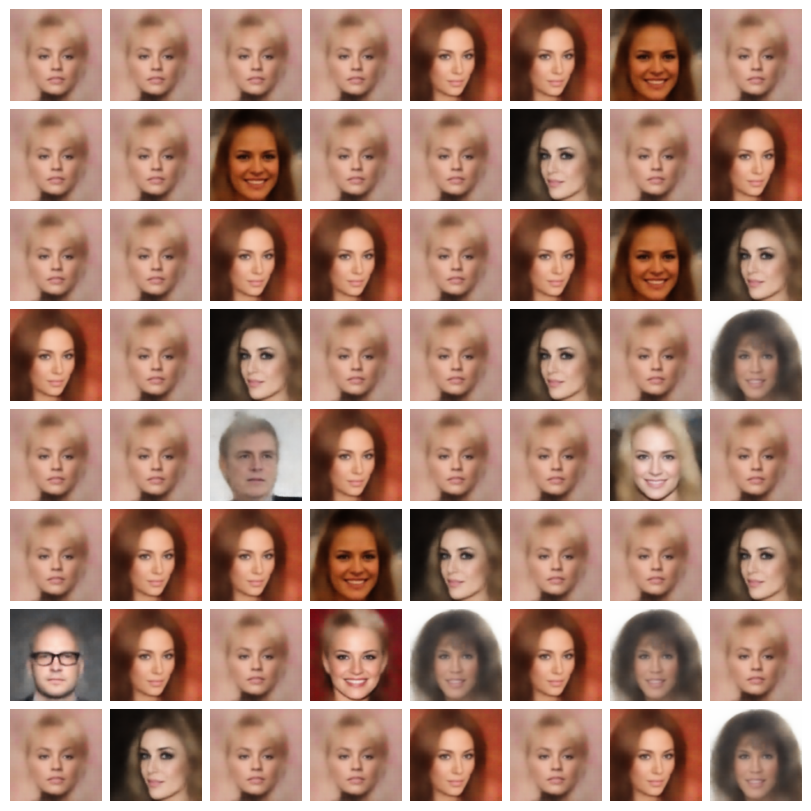

In [73]:
## sampling from langevin MC

#### HPARAMS ####
GAUSE_STD = 1
STEP = 1 
WEIGHT = 0.5
K = 50
#################

def potential(z, encodings, sigma=GAUSE_STD, pot=True) :
    z = z.view(-1, 1, encodings.shape[-1])
    ans = 0
    ans = torch.exp(-torch.norm(z-encodings, dim=-1)**2 / (2*sigma*sigma)).max(-1).values
    if pot : return -torch.log(ans)
    return ans

def log_Q(potential, encodings, z_prime, z, step):
    z.requires_grad_()
    grad = torch.autograd.grad(potential(z, encodings).mean(), z)[0]
    return -(torch.norm(z_prime - z + step * grad, p=2, dim=1) ** 2) / (4 * step)

def metropolis_adjusted_langevin_algorithm(potential, encodings, n_samples=100000, step=0.001, k=50, use_conf=False):
    burn_in = 1000
    weight = WEIGHT
    Z0 = torch.randn(1, encodings.shape[-1])
    THRESH = 0.3; c=0; p=1
    Zi = Z0
    samples = []
    returnable = []
    sample_conf = []
    log_ratios = []
    grads = []
    acc = []
    steps = []
    pbar = tqdm(range(k*n_samples + burn_in)) if not use_conf else tqdm(range(burn_in))
    for _ in pbar :
        Zi.requires_grad_()
        u = potential(Zi, encodings).mean()
        grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
        st_one = -step *grad
        st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
        with torch.no_grad() : 
            if potential(Zi, encodings, pot=False) < 0.9 : st = st_one
            else : st = st_two - Zi.detach()
        prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
        log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                    log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
        log_ratios.append(log_ratio.detach().item())
        if True : # torch.rand(1) < torch.exp(log_ratio):
            Zi = prop_Zi; acc.append(1)
        else : acc.append(0)
        samples.append(Zi.detach().numpy())
        sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
    if use_conf :
        print('Now Sampling...')
        while True :
            Zi.requires_grad_()
            u = potential(Zi, encodings).mean()
            grad = torch.autograd.grad(u, Zi)[0]; grads.append(grad)
            st_one = -step*grad
            st_two = weight * np.sqrt(2 * step) * torch.randn(1, encodings.shape[-1])
            with torch.no_grad() : 
                if potential(Zi, encodings, pot=False) <0.9 : st = st_one
                else : st = st_two
            # st = st_one + st_two # 3*st_one/st_one.norm() + 3*st_two/st_two.norm()
            # st /= st.norm()
            prop_Zi = Zi.detach() + st; steps.append(st.norm().item())
            log_ratio = -potential(prop_Zi, encodings).mean() + potential(Zi, encodings).mean() +\
                        log_Q(potential, encodings, Zi, prop_Zi, step) - log_Q(potential, encodings, prop_Zi, Zi, step)
            log_ratios.append(log_ratio.detach().item())
            if torch.rand(1) < torch.exp(log_ratio):
                Zi = prop_Zi; acc.append(1)
            else : acc.append(0)
            if potential(Zi.detach(), encodings, pot=False)>=THRESH : returnable.append(Zi.detach().numpy()); c+=1; print(c, end=' : ')
            sample_conf.append(potential(Zi.detach(), encodings, pot=False).item())
            if c>=n_samples : break
        return np.concatenate(returnable, 0), grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
    return np.concatenate(samples, 0)[burn_in::k], grads, acc, np.concatenate(samples, 0)[:burn_in], sample_conf, steps, log_ratios
print(pivots.shape)
latents, grads, acc, burns, confs, steps, log_ratios = metropolis_adjusted_langevin_algorithm(potential, pivots, n_samples=64, k=K, step=STEP, use_conf=False) # change 64 to 1000 later

model.eval()
with torch.no_grad():
    generated_imgs = model.decoder(torch.tensor(latents, device='cuda:1'))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs[:64] * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()

In [74]:
transform = transforms.Compose([
                transforms.ToTensor(),
                transforms.CenterCrop((160, 160))
            ])
dataset = CelebA_Dataset('data_celebA/img_align_celeba', transforms=transform)
generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8)
loader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=False)
images_actual = np.uint8(next(iter(loader)).numpy()*255)

fid = calculate_fid(inc_model, generated_imgs2.reshape(images_actual.shape), images_actual)
print(f'FID ({images_actual.shape[0]} images) : {fid}')

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 158ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
FID (64 images) : 66.91344451904297


torch.Size([64, 100])


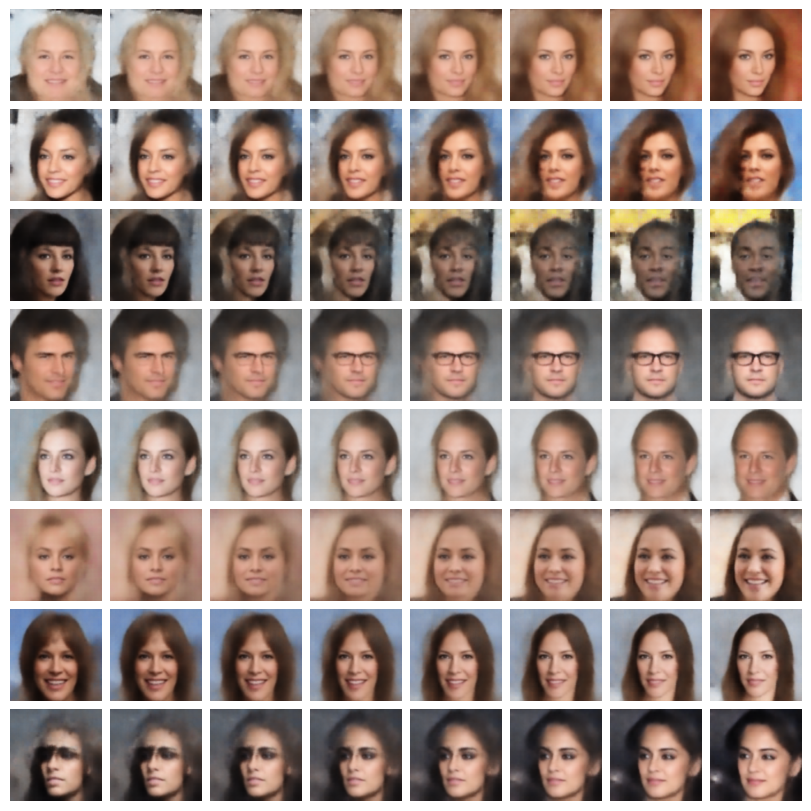

In [75]:
numlines = 8
points_per_line = 8
pivots_walk = (pivots[0] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[1]-pivots[0])[None,:])[1:-1]
for i in range(1, numlines) :
    pivots_walk = torch.cat((pivots_walk, (pivots[2*i] + torch.linspace(0, 1, points_per_line+2)[:,None]*(pivots[2*i+1]-pivots[2*i])[None,:])[1:-1]), dim=0)
# pivots_walk = pivots_walk[1:-1, :]
print(pivots_walk.shape)

model.eval()
with torch.no_grad():
    generated_imgs = model.decoder(pivots_walk.cuda(1))
    generated_imgs = generated_imgs.cpu().numpy()

generated_imgs2 = np.array(generated_imgs * 255, dtype=np.uint8).reshape(8, 8, 3, 160, 160)
 
fig = plt.figure(figsize=(8, 8), constrained_layout=True)
gs = fig.add_gridspec(8, 8)
for n_col in range(8):
    for n_row in range(8):
        f_ax = fig.add_subplot(gs[n_row, n_col])
        f_ax.imshow(generated_imgs2[n_row, n_col].swapaxes(0,1).swapaxes(1,2))
        f_ax.axis("off")
plt.show()